<h1 align = 'center', style = 'color : red'><u>Credit Risk Prediction using Machine Learning</u></h1>

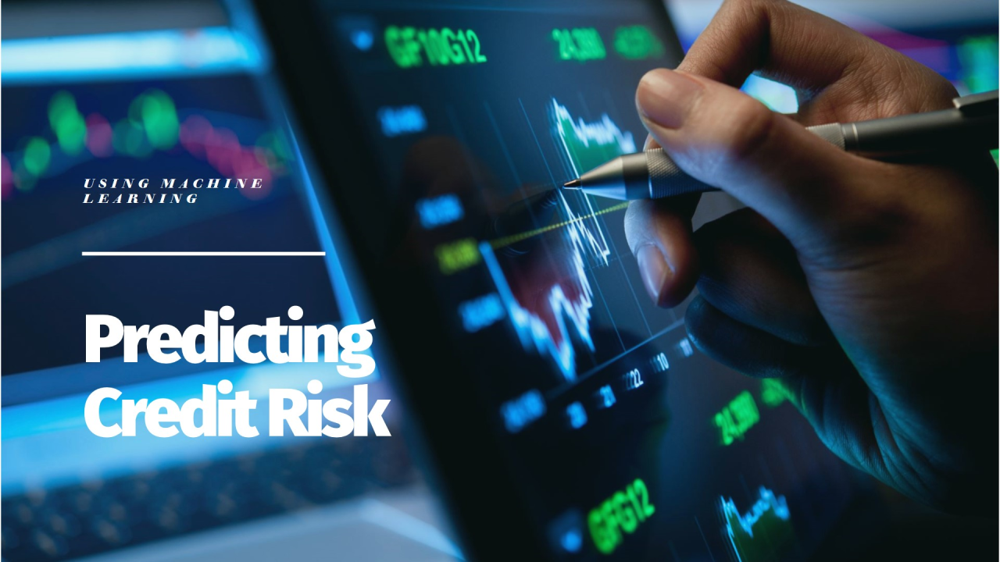

<h2 style = 'color : indianred'>Project Overview</h2>

#### This project focuses on predicting loan default using a credit risk dataset. We will analyze borrower details, preprocess data, apply machine learning models, and evaluate their performance.

<h3 style = 'color : lightcoral'>Problem Statement</h2>

#### Financial institutions need a risk assessment model to predict whether a borrower will default on a loan. Using historical data, you will build a machine learning model to classify borrowers as low risk (no default) or high risk (default).

<h3 style = 'color : tomato'>Dataset Overview</h2>

* Total Records: 100,000
* Features: 19 independent variables + 1 target variable (default)
* Target Variable (default):
    * 0 → No Default (Loan Repaid)
    * 1 → Default (Loan Not Repaid)
* Feature Categories:
1. Personal & Demographic – Age, employment status, education level, marital
status.
2. Financial Information – Income, loan amount, loan term, interest rate,
savings.
3. Credit History – Credit score, credit history length, number of credit lines,
late payments, bankruptcies.


## Importing the dependencies

In [131]:
import os  # File and folder operations                     
import pandas as pd  # Data Manipulation  
import numpy as np   # Numeric calculations
import matplotlib.pyplot as plt   # Visualization
%matplotlib inline   
# To keep the visualization within a cell
import seaborn as sns   # Advanced data visualization
sns.set()   # Setting the seaborn formatting
import plotly.express as px  # Interactive data visualization
import warnings # Remove unnecessary warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None) # To dislay all the rows

from sklearn.model_selection import train_test_split # To split the dataset into training and testing
from sklearn.model_selection import GridSearchCV  # To perform Hyperparameter tuning.
from sklearn.neighbors import KNeighborsClassifier # To implement K Nearest classifier algorithm
from sklearn.naive_bayes import GaussianNB # To implement Naive Bayes classifier algorithm
from sklearn.linear_model import LogisticRegression # To implement Logistic Regression algorithm
from sklearn.svm import SVC # To implement SVC or Support Vector Classifier algorithm
from sklearn.tree import DecisionTreeClassifier # To implement Decision Tree Classifier algorithm
from sklearn.ensemble import RandomForestClassifier # To implement Random Forest classifier algorithm
from xgboost import XGBClassifier # To implement XGB classifier algorithm
from lightgbm import LGBMClassifier # To implement Light Gbm classifier algorithm
from catboost import CatBoostClassifier # To implement Cat boosting classifier algorithm
from sklearn.decomposition import PCA # Dimensionality Reduction technique.
from sklearn.preprocessing import StandardScaler, MinMaxScaler # To implement feature scaling and preprocessing
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, accuracy_score,precision_score, recall_score, f1_score # To Evaluate the model
import sweetviz as sv  # Data Visualizatio using Automation

import tensorflow as tf  # MLP Framework
from tensorflow import keras  # Wrapper for using MLP
from keras import Sequential  # Sequential Model
from keras.layers import Dense, Dropout, BatchNormalization  # MLP layers
from keras.callbacks import EarlyStopping  # Early Stopping to stop execution based on some metric.

# 1. <u>Understanding the Dataset</u>
## <u> Task</u>s

### 1. Load the dataset and explore its structure

In [4]:
df = pd.read_csv('Credit Card Fraud Detection.csv') # Storing the data in pandas DataFrame object after reading it from Credit Card Fraud Detection.csv file
df.head() # Displaying first 5 rows

,age,income,loan_amount,credit_score,employment_status,default(y),loan_term,interest_rate,debt_to_income_ratio,num_of_dependents,education_level,home_ownership,marital_status,credit_history_length,num_credit_lines,late_payments,bankruptcies,annual_savings,retirement_savings,monthly_expenses
0,38,71440,27069,689,self-employed,1,36,9.937874,31.046101,0,high_school,rent,married,7,6,1,1,25259,195208,6037
1,36,90200,14895,578,employed,0,48,13.624882,21.845252,0,high_school,own,married,11,16,8,0,40761,152999,4064
2,47,85896,2613,352,employed,1,12,6.676366,12.562405,1,bachelor,mortgage,divorced,24,2,2,0,34857,67487,2848
3,38,20121,3163,622,unemployed,0,48,12.833366,17.144545,1,master,own,married,12,4,6,1,16048,98869,7721
4,44,77529,37731,615,self-employed,0,12,4.111636,35.892430,3,high_school,own,single,27,7,5,0,5668,42397,8009


In [4]:
df.shape # No. of Records(rows) in the dataframe, No. of Features(Columns)

(100000, 20)

In [5]:
df.columns # Checking all the feature names

Index(['age', 'income', 'loan_amount', 'credit_score', 'employment_status',
       'default(y)', 'loan_term', 'interest_rate', 'debt_to_income_ratio',
       'num_of_dependents', 'education_level', 'home_ownership',
       'marital_status', 'credit_history_length', 'num_credit_lines',
       'late_payments', 'bankruptcies', 'annual_savings', 'retirement_savings',
       'monthly_expenses'],
      dtype='object')

In [6]:
# exploring the datatypes and 4-point summary

In [10]:
df.info() # information regarding data type, memory consumption, null values, etc.,

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 20 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   age                    100000 non-null  int64  
 1   income                 100000 non-null  int64  
 2   loan_amount            100000 non-null  int64  
 3   credit_score           100000 non-null  int64  
 4   employment_status      100000 non-null  object 
 5   default(y)             100000 non-null  int64  
 6   loan_term              100000 non-null  int64  
 7   interest_rate          100000 non-null  float64
 8   debt_to_income_ratio   100000 non-null  float64
 9   num_of_dependents      100000 non-null  int64  
 10  education_level        100000 non-null  object 
 11  home_ownership         100000 non-null  object 
 12  marital_status         100000 non-null  object 
 13  credit_history_length  100000 non-null  int64  
 14  num_credit_lines       100000 non-nul

##### We can oberve that the features which are non-numeric i.e., employment_status, education_level, home_ownership and marital_status are correctly given as object data type. Hence, no transofrmation is required.

In [11]:
df.describe(include = 'all').T # Basic Statistical summary of the data with 5 point summary (checking for non-numerical values too.)

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
age,100000.0,NaN,NaN,NaN,42.46272,12.690258,21.0,31.0,42.0,53.0,64.0
income,100000.0,NaN,NaN,NaN,60012.22496,23093.209173,20000.0,39935.75,60175.0,79991.0,99998.0
loan_amount,100000.0,NaN,NaN,NaN,25519.56195,14136.260198,1000.0,13311.75,25583.0,37771.0,49999.0
credit_score,100000.0,NaN,NaN,NaN,573.80676,158.581563,300.0,437.0,574.0,710.0,849.0
employment_status,100000,3,employed,70310,NaN,NaN,NaN,NaN,NaN,NaN,NaN
default(y),100000.0,NaN,NaN,NaN,0.50094,0.500002,0.0,0.0,1.0,1.0,1.0
loan_term,100000.0,NaN,NaN,NaN,36.02556,16.964051,12.0,24.0,36.0,48.0,60.0
interest_rate,100000.0,NaN,NaN,NaN,9.254996,3.318369,3.500245,6.377951,9.269498,12.113304,14.999895
debt_to_income_ratio,100000.0,NaN,NaN,NaN,29.995874,11.563967,10.000275,19.973035,30.007073,40.034245,49.999915
num_of_dependents,100000.0,NaN,NaN,NaN,1.99735,1.417576,0.0,1.0,2.0,3.0,4.0


### 2. Check the types of variables (numerical vs. categorical)

In [9]:
# let us seggregate our columns into categorical, non-categorical, discrete and continuous

In [5]:
categorical = []  # Created a list object to store all the categorical values.
non_categorical = [] # Created a list object to store all the non-categorical values.
discrete = [] # Created a list object to store all the discrete values.
continuous = [] # Created a list object to store all the continuous values.

for cols in df:
    if df[cols].dtype == 'object':
        if df[cols].nunique() < 10: # Here, 10 is just a random number, we can pick any value but that should not be too high or too low in order to capture the categorical columns effectively.
            categorical.append(cols) 
        else:
            non_categorical.append(cols)
    else:
        if df[cols].nunique() < 10:
            discrete.append(cols)
        else:
            continuous.append(cols)

# Printing the results
print(f'Categorical Features -> {categorical}')
print(f'Non-Categorical Features -> {non_categorical}')
print(f'Discrete Features -> {discrete}')
print(f'Continuous Features -> {continuous}')

Categorical Features -> ['employment_status', 'education_level', 'home_ownership', 'marital_status']
Non-Categorical Features -> []
Discrete Features -> ['default(y)', 'loan_term', 'num_of_dependents', 'bankruptcies']
Continuous Features -> ['age', 'income', 'loan_amount', 'credit_score', 'interest_rate', 'debt_to_income_ratio', 'credit_history_length', 'num_credit_lines', 'late_payments', 'annual_savings', 'retirement_savings', 'monthly_expenses']


### 3. Identify missing values, duplicates, and outliers.

#### <u>Missing Values</u>

In [14]:
df.isna().sum() # Summng up all the null values in a particular column.

age                      0
income                   0
loan_amount              0
credit_score             0
employment_status        0
default(y)               0
loan_term                0
interest_rate            0
debt_to_income_ratio     0
num_of_dependents        0
education_level          0
home_ownership           0
marital_status           0
credit_history_length    0
num_credit_lines         0
late_payments            0
bankruptcies             0
annual_savings           0
retirement_savings       0
monthly_expenses         0
dtype: int64

##### We can see that our data has no missing values.

#### <u>Duplicates</u>

In [23]:
df[df.duplicated()] # filtered the data frame for rows containing duplicates

,age,income,loan_amount,credit_score,employment_status,default(y),loan_term,interest_rate,debt_to_income_ratio,num_of_dependents,education_level,home_ownership,marital_status,credit_history_length,num_credit_lines,late_payments,bankruptcies,annual_savings,retirement_savings,monthly_expenses


##### We can see that our data is free from any duplicate values

#### <u>Outliers</u>

##### We can only find outliers in our **Continuous column**.

##### Lets create a function to detect outliers in a given column

In [6]:
def outlier_feature(column):  # function that takes in a column name and return outliers (if any)
    q1 = df[column].quantile(0.25) # first quantile value
    q3 = df[column].quantile(0.75) # third quantile value
    iqr = q3 - q1                  # inter-quartile range
    upper_limit = q3 + 1.5*iqr     # upper limit beyond which a value is treated as an outlier
    lower_limit = q1 - 1.5*iqr     # lower limit below which a value is considered as an outlier
    outlier = [value for value in df[column] if value > upper_limit or value < lower_limit] # list object to store the outliers
    if outlier:
        return f'This column has outliers --> {outlier}'
    else:
        return 'No Outliers found'

##### Now we shall check for outliers for each column in Continuous 

In [7]:
for cols in continuous:
    print(f'{cols} --> {outlier_feature(cols)}')
    print()

age --> No Outliers found

income --> No Outliers found

loan_amount --> No Outliers found

credit_score --> No Outliers found

interest_rate --> No Outliers found

debt_to_income_ratio --> No Outliers found

credit_history_length --> No Outliers found

num_credit_lines --> No Outliers found

late_payments --> No Outliers found

annual_savings --> No Outliers found

retirement_savings --> No Outliers found

monthly_expenses --> No Outliers found



##### Great! we have no outliers in any of the features in our dataset.

### 4. Analyze class distribution to check for imbalances.

##### Here, our target variable is '**default(y)**'. if one of the value is greated than twice the other value, the class is considered as imbalanced.

In [16]:
df['default(y)'].value_counts(normalize = True)*100 # Gives the percentage of both the values in the dataset.

default(y)
1    50.094
0    49.906
Name: proportion, dtype: float64

##### Since we can detect no major difference, we can conclude that our **class is balanced**

## <u>Questions</u>

### What are the key features affecting credit risk?

In our dataset, we have 19 features that impact the credit risk in some way or the other.
We have 5 broad categories in which all these features fall.
These are:

**Demographic Features**
1. age (integer, 21–65 years)- Age of the borrower. Older individuals may have a longer
credit history, impacting risk assessment.
2. num_of_dependents (integer, 0–4)- Number of dependents (e.g., children, spouse,
elderly parents). More dependents can impact financial stability.
3. education_level (categorical: "high_school", "bachelor", "master", "phd") -Highest level
of education attained. Higher education may be correlated with higher income and
financial stability.
4. marital_status (categorical: "single", "married", "divorced") - Marital status of the
borrower. Married individuals may have joint income but also higher xpenses.

**Financial Features**

5. income (integer, 20,000 USD–100,000 USD)- Annual income of the borrower. Higher income
generally reduces the risk of default.
6. loan_amount (integer, 1,000 USD–$50,000 USD)- Amount of money borrowed. Larger loans
may carry a higher risk of default.
7. loan_term (categorical: 12, 24, 36, 48, 60 months)- Duration of the loan in months.
Longer terms may increase risk due to financial uncertainty.
8. interest_rate (float, 3.5%–15.0%)- Annual interest rate on the loan. Higher rates
increase repayment burden.
9. debt_to_income_ratio (float, 10%–50%)- Ratio of total debt payments to income. Higher
values indicate financial stress.
10. home_ownership (categorical: "own", "rent", "mortgage")- Indicates whether the
borrower owns a home, rents, or has a mortgage. Homeowners may have more
financial stability.


**Credit History Features**

11. credit_score (integer, 300–850)- Numerical representation of the individual's creditworthiness.
Higher scores indicate lower risk.
12. credit_history_length (integer, 1–30 years)- Number of years the borrower has had a credit
history. Longer history generally means better creditworthiness.
13. num_credit_lines (integer, 1–20)- Number of active credit lines (e.g., credit cards, loans). Too
many or too few can be risky.
14. late_payments (integer, 0–9)- Number of late payments in the borrower's credit history. More
late payments increase default risk.
15. bankruptcies (integer, 0–2)- Number of past bankruptcies. Even a single bankruptcy
significantly increases the risk of default.

**Savings & Expense Features**

16. annual_savings (integer, 500 USD–50,000 USD)- Amount saved annually. Higher savings indicate
financial stability.
17. retirement_savings (integer, 1,000USD–200,000USD)- Money saved for retirement. Indicates longterm financial planning.
18. monthly_expenses (integer, 500USD–$10,000USD)- Total monthly expenses. Higher expenses relative
to income may increase risk.


**Employment Features**

19. employment_status (categorical: "employed", "unemployed", "self-employed"

* Employment status of the borrower.
* Employed: Steady income source, lower risk.
* Unemployed: No stable income, high risk.
* Self-employed: Variable income, moderate risk.risk.

##### **Note: The degree or extent to which these features affect the credit risk are varied and can be calculated once our algorithm is ready.**
##### **We shall go through the importance or individual impact of these features again once we start the predictive analysis.**

### How is the target variable (default) distributed?

##### Let us plot a pie chart to show the distribution of our target variable an intutive way.

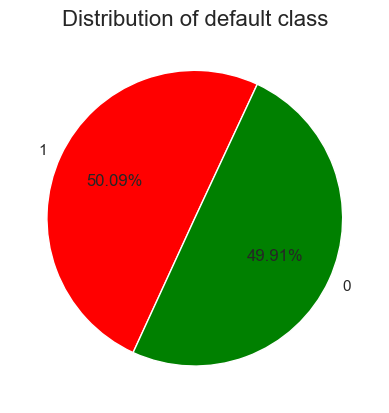

In [18]:
plt.pie(x = df['default(y)'].value_counts().values, labels = df['default(y)'].value_counts().index, colors = ['red', 'green'], autopct = '%.2f%%', startangle = 65)
# Plotting a Pie chart using Matplotlib's pie chart with red color showing defaults and green color showing non-defaults.
plt.title('Distribution of default class', fontsize = 16)
plt.show()

### Are there any missing values or inconsistencies?

##### As checked earlier, none of our columns has missing values and hence the total missing values is equal to 0.

In [46]:
df.isna().sum()

age                      0
income                   0
loan_amount              0
credit_score             0
employment_status        0
default(y)               0
loan_term                0
interest_rate            0
debt_to_income_ratio     0
num_of_dependents        0
education_level          0
home_ownership           0
marital_status           0
credit_history_length    0
num_credit_lines         0
late_payments            0
bankruptcies             0
annual_savings           0
retirement_savings       0
monthly_expenses         0
dtype: int64

In [19]:
df.isna().sum().sum()  # Total number of missing values in our data.

0

##### As checked earlier, all the data is consistent with the data types provided. Lets have a look.

In [49]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 20 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   age                    100000 non-null  int64  
 1   income                 100000 non-null  int64  
 2   loan_amount            100000 non-null  int64  
 3   credit_score           100000 non-null  int64  
 4   employment_status      100000 non-null  object 
 5   default(y)             100000 non-null  int64  
 6   loan_term              100000 non-null  int64  
 7   interest_rate          100000 non-null  float64
 8   debt_to_income_ratio   100000 non-null  float64
 9   num_of_dependents      100000 non-null  int64  
 10  education_level        100000 non-null  object 
 11  home_ownership         100000 non-null  object 
 12  marital_status         100000 non-null  object 
 13  credit_history_length  100000 non-null  int64  
 14  num_credit_lines       100000 non-nul

##### The columns employment_status, education_level, home_ownership and marital_status are supposed to be Object columns and all other columns should be numeric which is True. 

# 2. Exploratory Data Analysis (EDA)
## <u>Tasks</u>### 1. Visualize the distribution of numerical features.

##### We shall create *Pie Charts* for our **Discrete Features** and *Histogram Plots* and *Box Plots* for our **Continuous variables**.

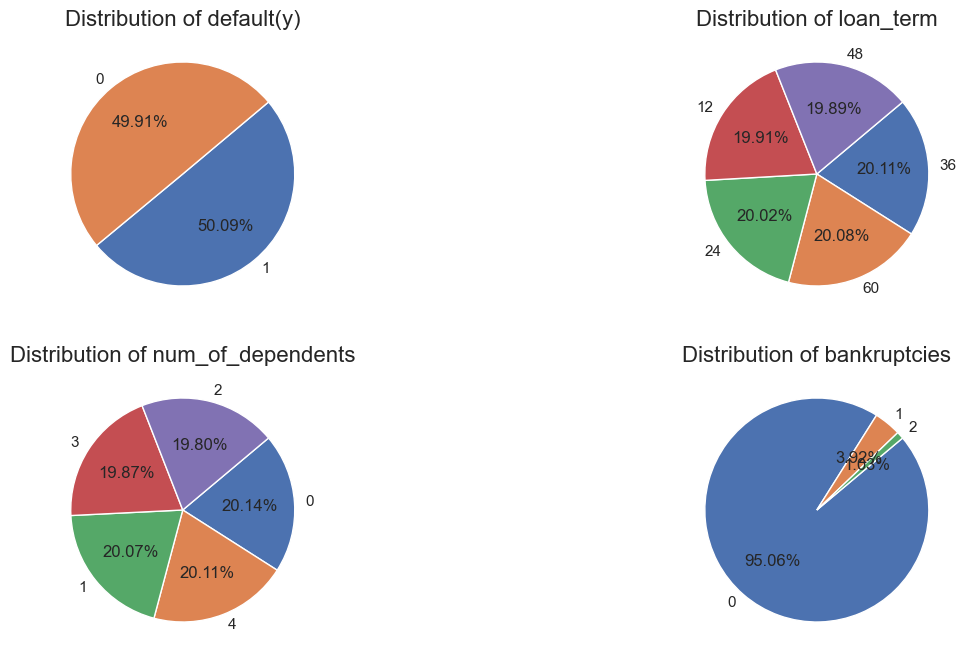

In [22]:
plt.figure(figsize = (15,8))
i = 0
while i < len(discrete):
    plt.subplot(int(np.ceil(len(discrete)/2)), 2, i+1) # Using matplotlib's subplot feature to create charts in a grid for better representation.
    # plt.subplot takes in(number of rows, number of columns and position argument starting from 1) we have created number of rows attribute such that
    # it dynamically accepts whatever the number of features we have in discrte features list.
    plt.pie(x = df[discrete[i]].value_counts().values, labels = df[discrete[i]].value_counts().index, 
            autopct = '%.2f%%', startangle = 40, counterclock = False)
    plt.title(f'Distribution of {discrete[i]}', fontsize = 16)
    i+=1
plt.show()

##### Displots

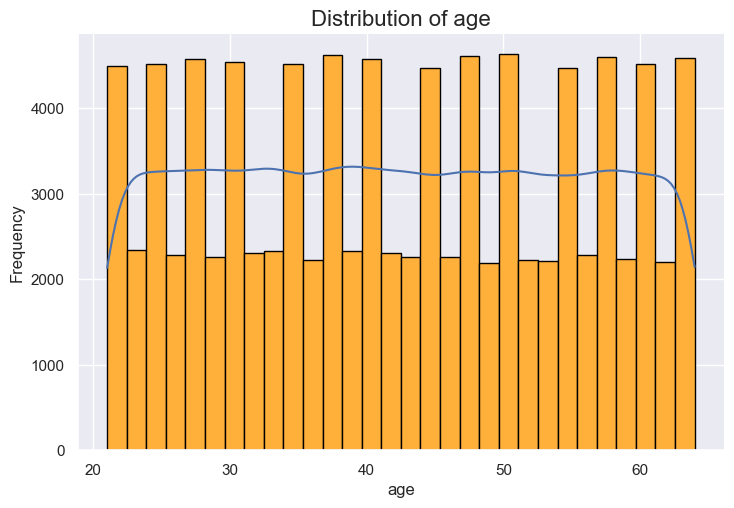

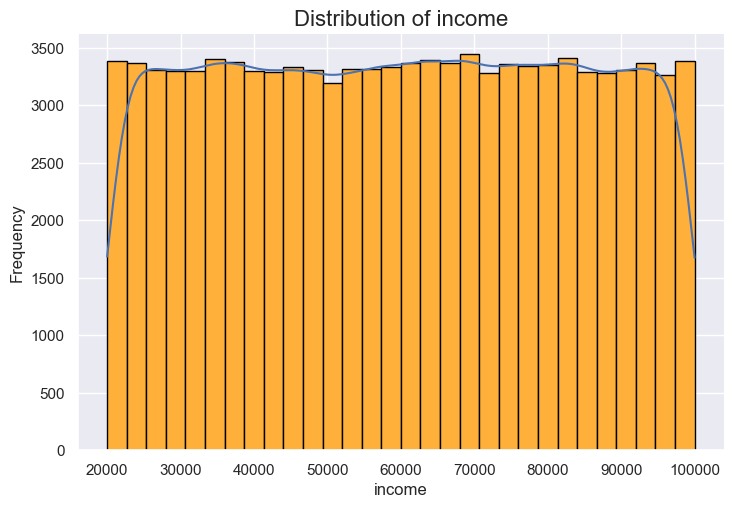

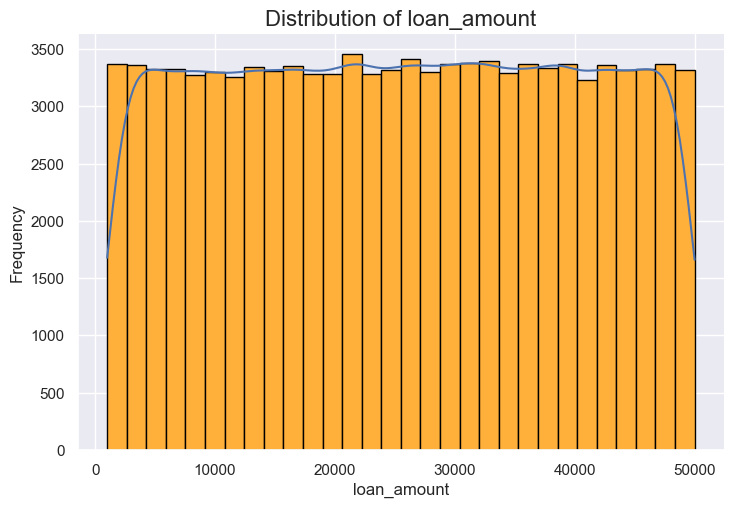

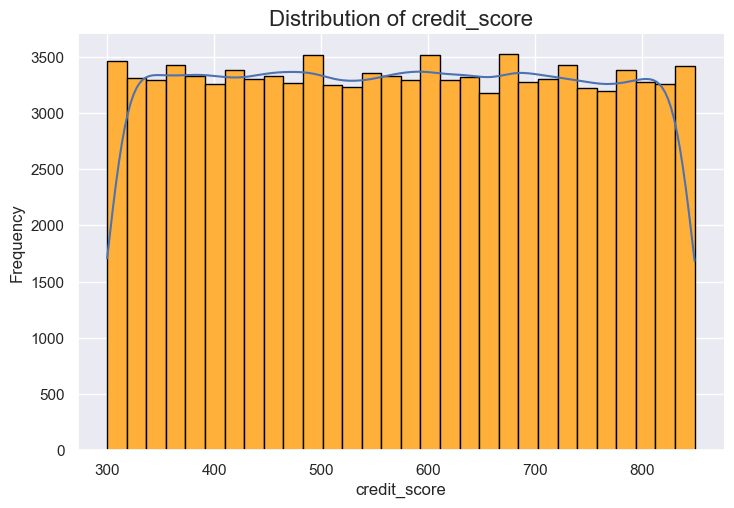

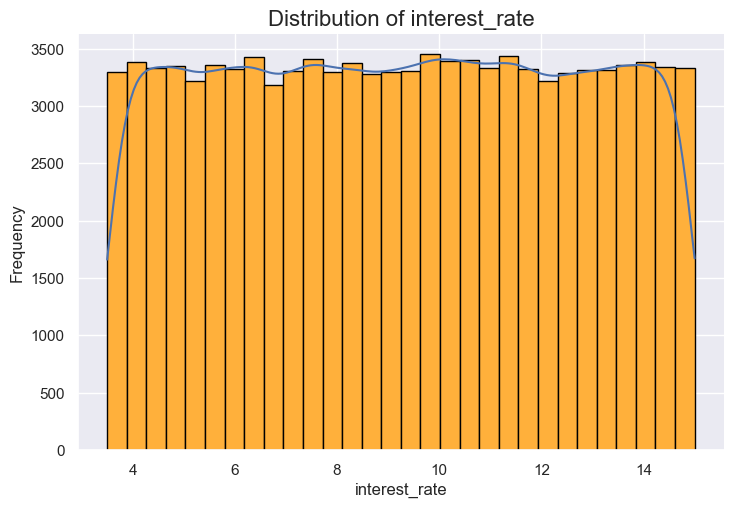

...

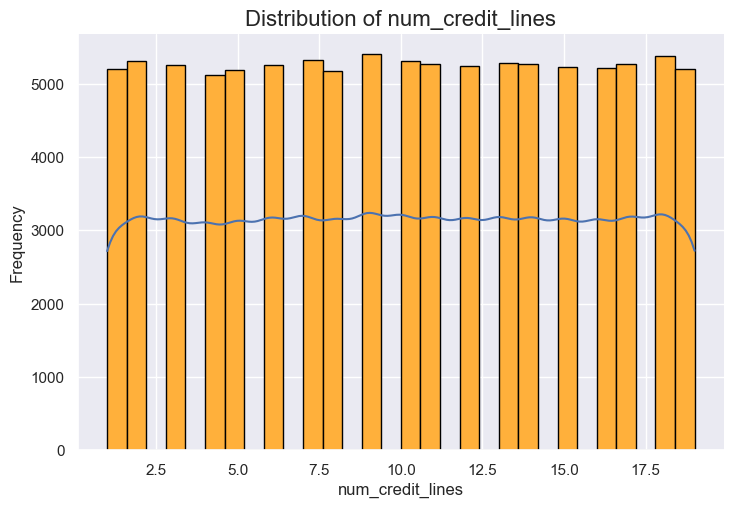

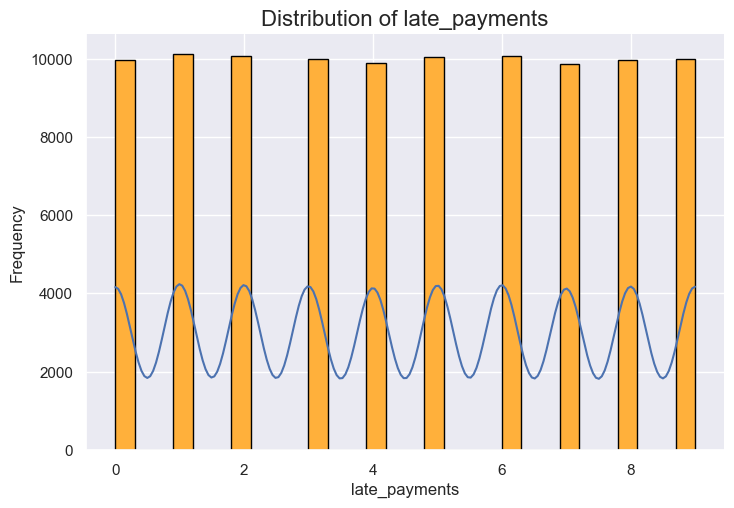

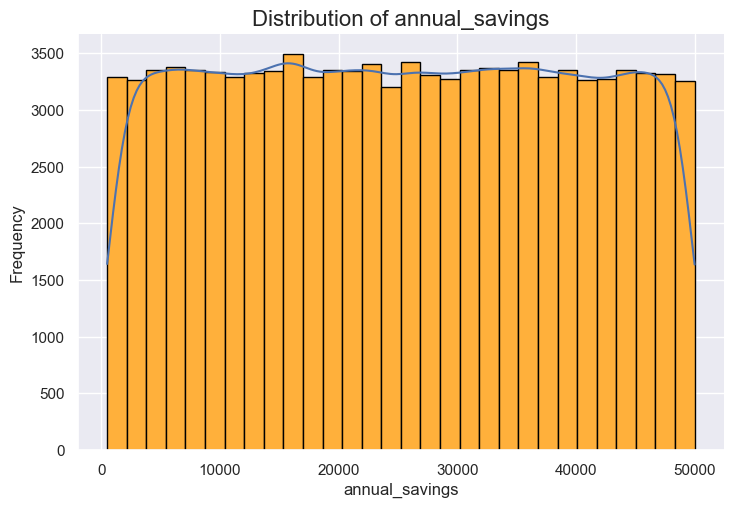

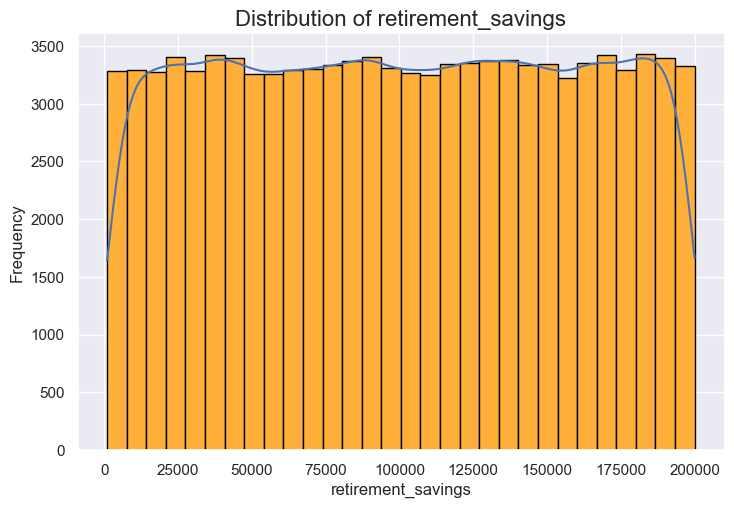

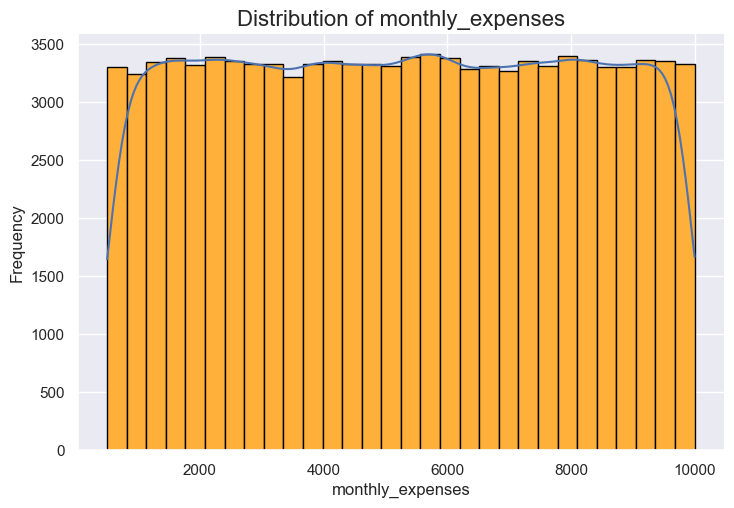

In [25]:
for cols in continuous:
    sns.displot(data = df, x = cols, bins = 30, kde = True, edgecolor = 'black', facecolor = '#ffb03b', aspect = 1.5)
    # Creates a displot with kernel density estimate = True
    plt.xlabel(cols)
    plt.ylabel('Frequency')
    plt.title(f'Distribution of {cols}', fontsize = 16)
    plt.show()

##### Box Plots

In [67]:
# Let us now make the Box Plots

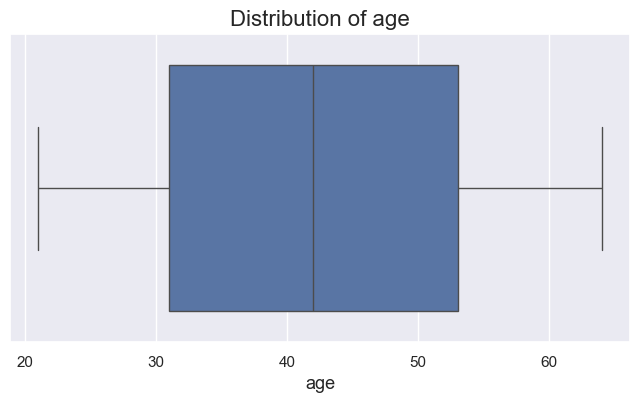

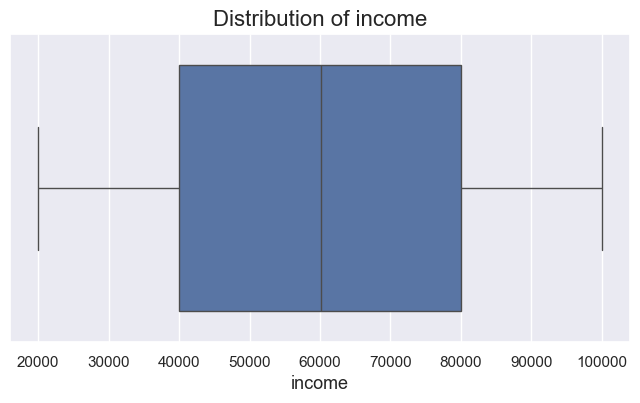

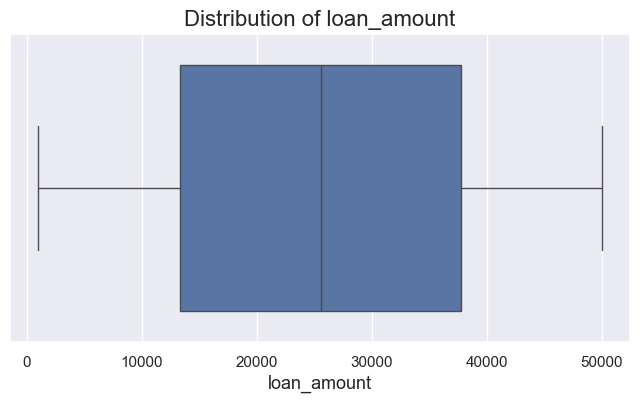

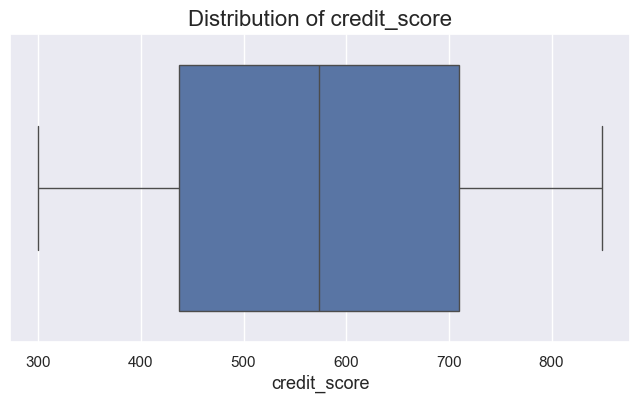

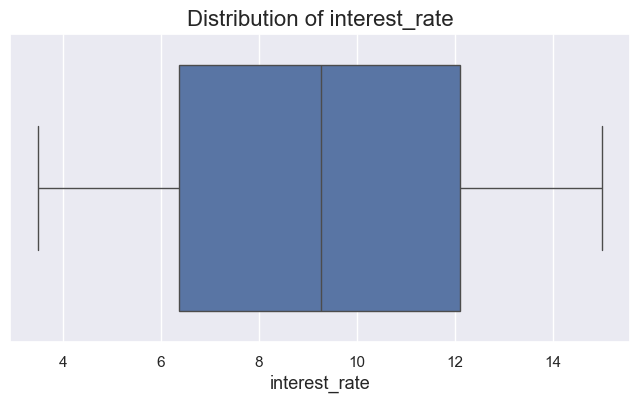

...

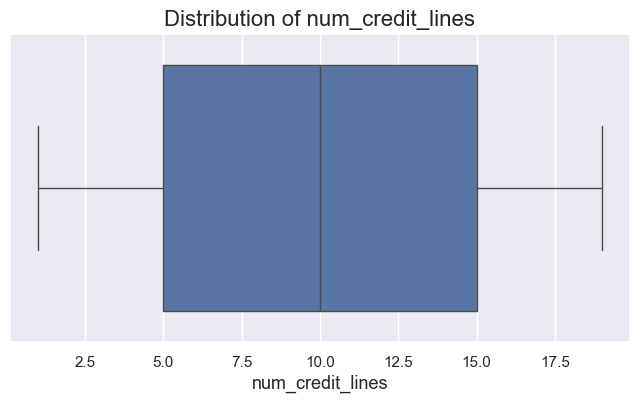

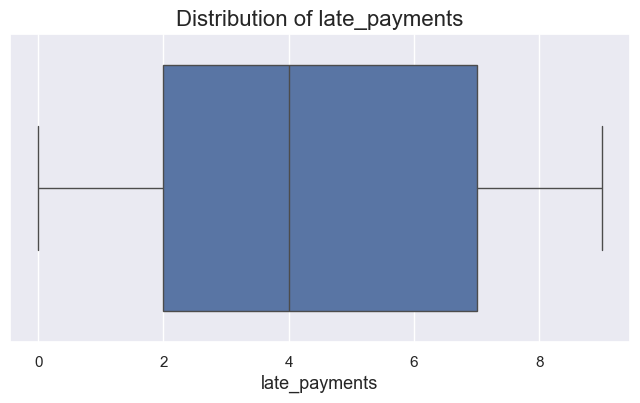

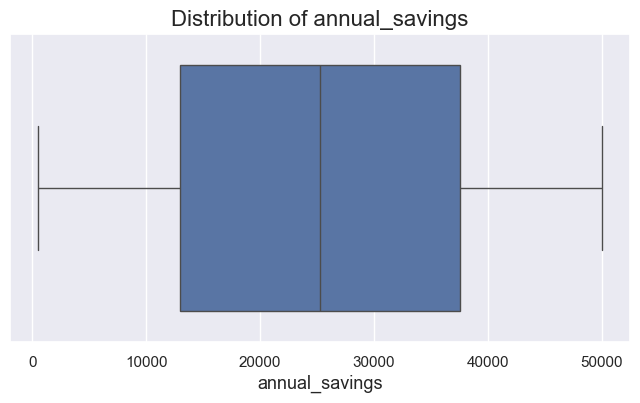

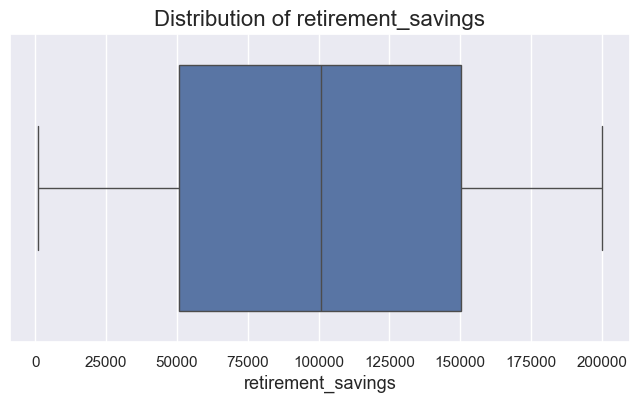

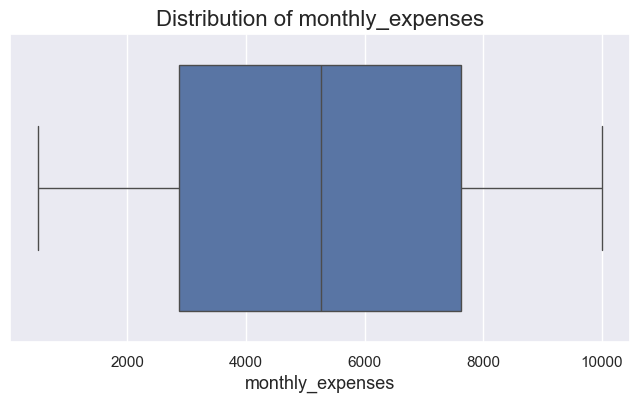

In [27]:
for cols in continuous:
    plt.figure(figsize = (8,4))
    sns.boxplot(data = df, x = cols)
    plt.title(f'Distribution of {cols}', fontsize = 16)
    plt.ylabel('')
    plt.xlabel(cols, fontsize = 13)
    plt.show()

### 2. Analyze correlations between variables.

##### We can do Correlation analysis between variable using **Scatter Plots** and **Heatmap**. While, scatter plots just gives us Qualitative analysis, of Continuous features, we
##### can get the exact or quantitative analysis for all the numerical features using Heatmap. Lets plot and study both.

##### Scatter Plots

In [29]:
# Lets display all the features again.
print(f'Categorical Features -> {categorical}')
print(f'Non-Categorical Features -> {non_categorical}')
print(f'Discrete Features -> {discrete}')
print(f'Continuous Features -> {continuous}')

Categorical Features -> ['employment_status', 'education_level', 'home_ownership', 'marital_status']
Non-Categorical Features -> []
Discrete Features -> ['default(y)', 'loan_term', 'num_of_dependents', 'bankruptcies']
Continuous Features -> ['age', 'income', 'loan_amount', 'credit_score', 'interest_rate', 'debt_to_income_ratio', 'credit_history_length', 'num_credit_lines', 'late_payments', 'annual_savings', 'retirement_savings', 'monthly_expenses']


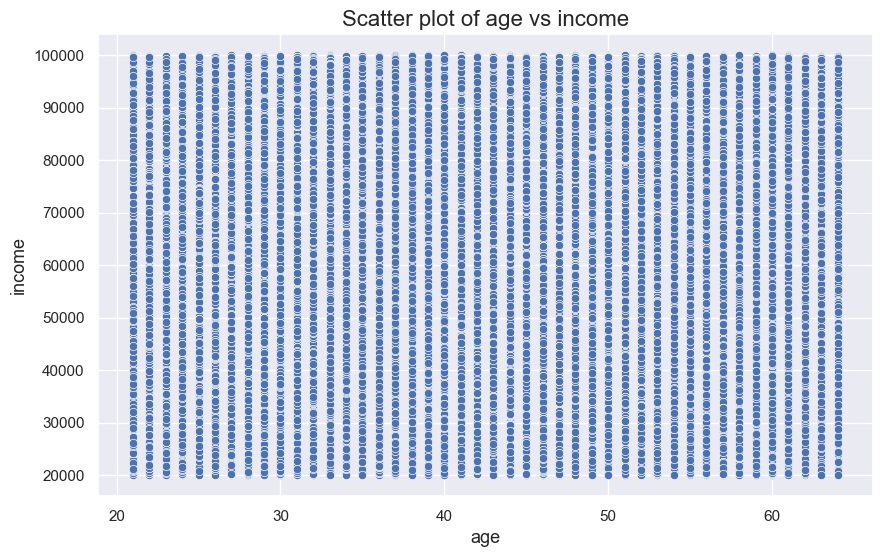

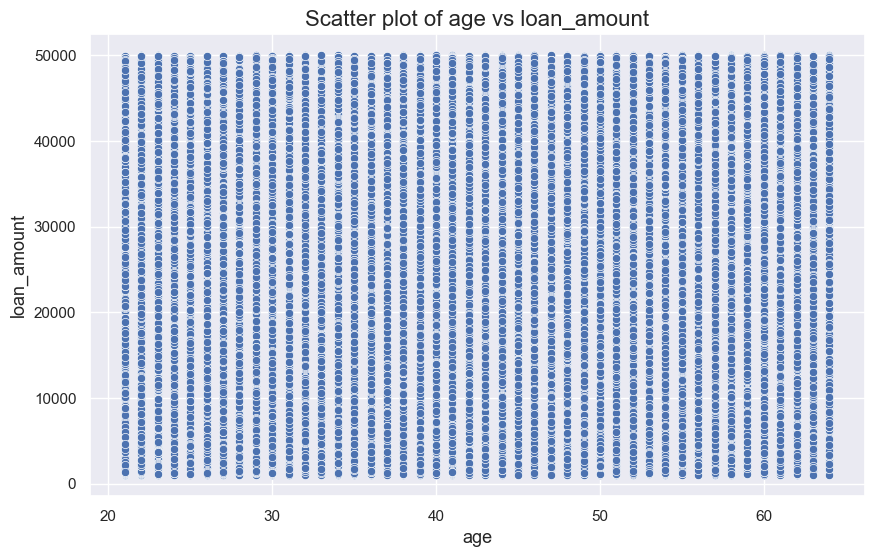

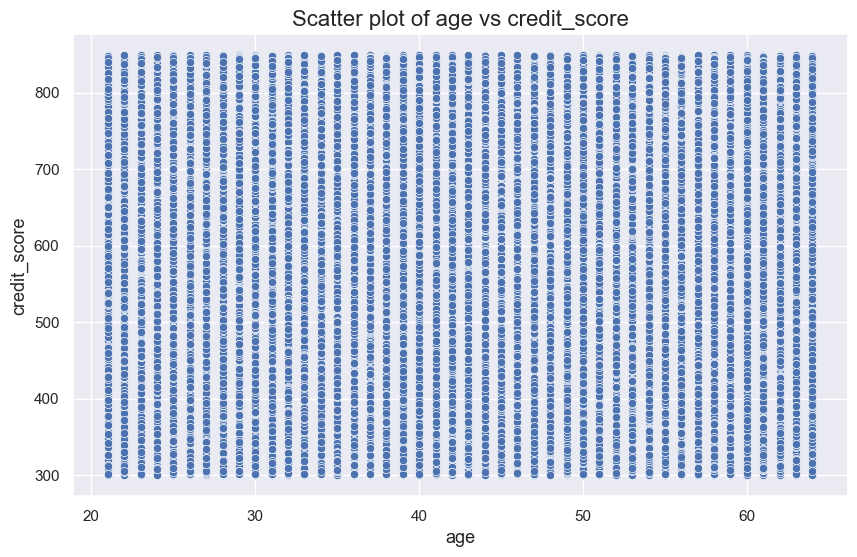

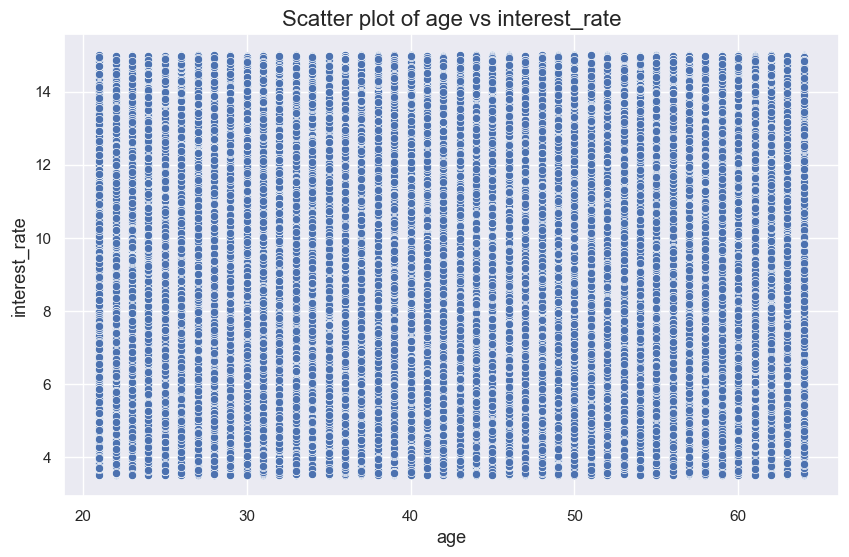

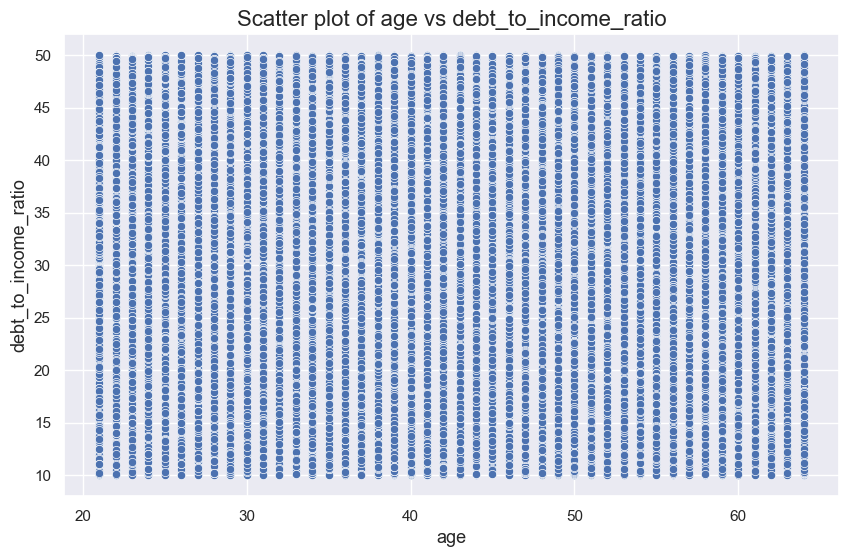

...

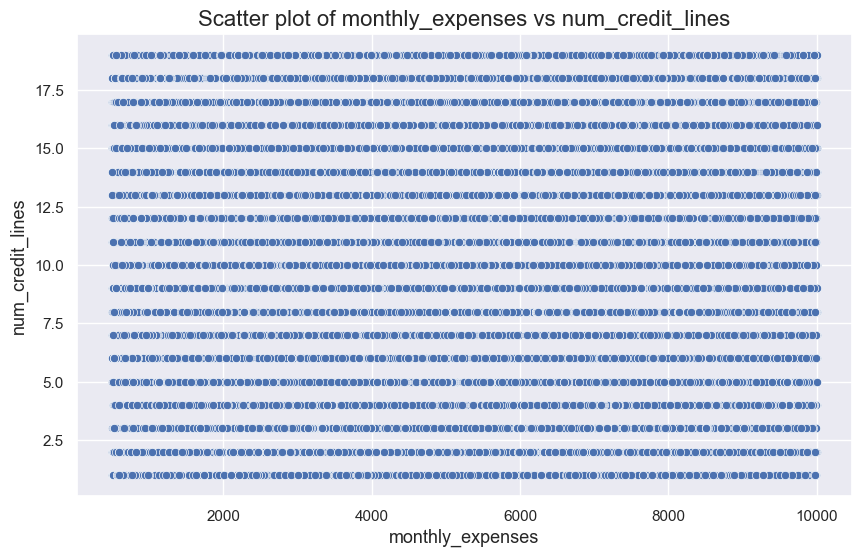

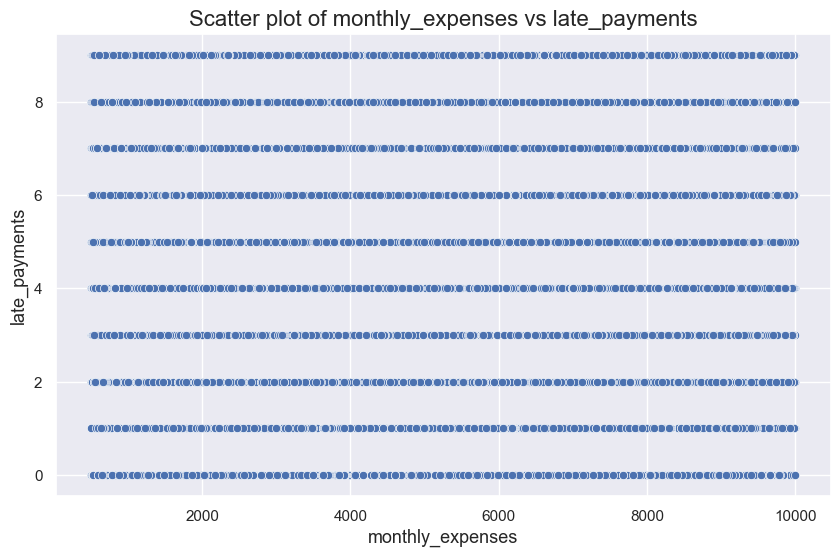

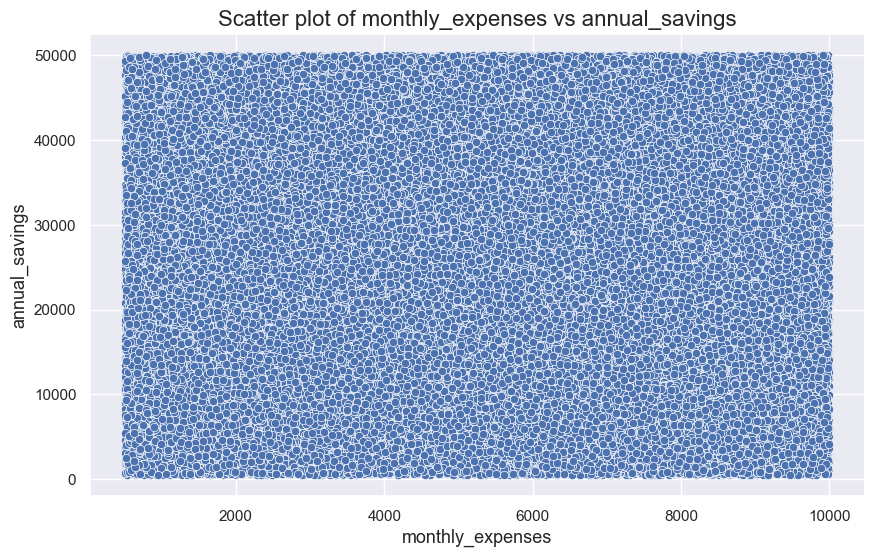

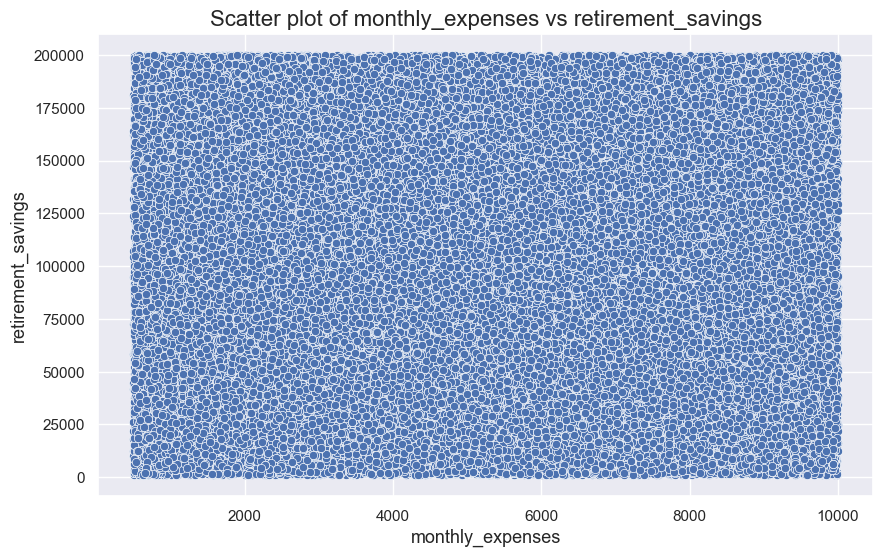

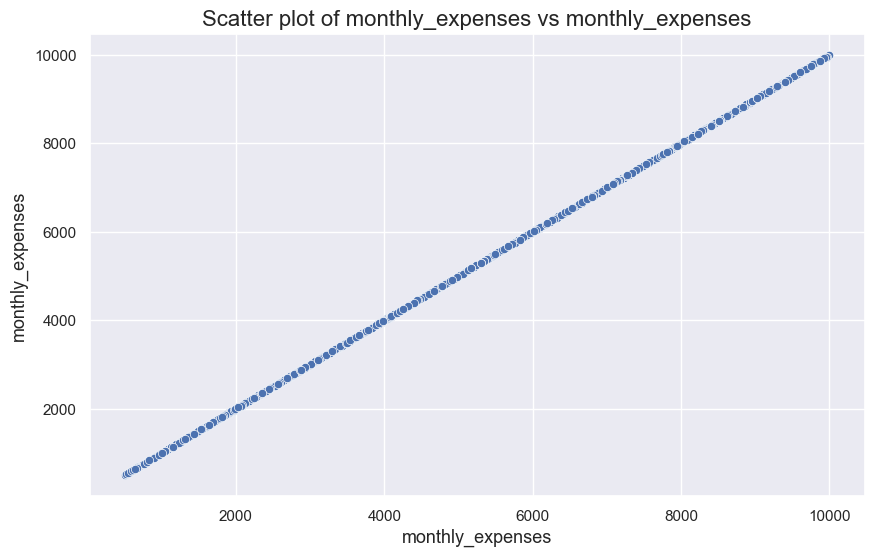

In [34]:
# Plotting scatter plots for all the Continuous variables.
for i in range(len(continuous)):
    for j in range(1,len(continuous)):
        plt.figure(figsize = (10,6))
        sns.scatterplot(data = df, x = continuous[i], y = continuous[j])
        plt.title(f'Scatter plot of {continuous[i]} vs {continuous[j]}', fontsize = 16)
        plt.xlabel(f'{continuous[i]}', fontsize = 13)
        plt.ylabel(f'{continuous[j]}', fontsize = 13)
        plt.show()

##### We can see that no relevant information can be fetched from these scatter plots. Let us quickly jump to plot the Heatmap.

In [1]:
# first let us view the correlations using correlation matrix

In [84]:
df.corr(numeric_only = True)

,age,income,loan_amount,credit_score,default(y),loan_term,interest_rate,debt_to_income_ratio,num_of_dependents,credit_history_length,num_credit_lines,late_payments,bankruptcies,annual_savings,retirement_savings,monthly_expenses
age,1.000000,0.001523,0.002053,0.003709,0.001084,0.003918,0.001894,0.004350,-0.004243,0.001007,-0.002773,-0.004052,-0.001057,-0.008502,-0.003290,-0.001569
income,0.001523,1.000000,0.004583,0.004645,0.004136,-0.003255,-0.002776,0.007808,0.002006,-0.001694,0.002391,0.002208,-0.005555,0.005925,0.002597,-0.000709
loan_amount,0.002053,0.004583,1.000000,-0.003172,0.001014,-0.001243,-0.000214,0.000209,0.003182,-0.003486,-0.006456,0.000987,0.001874,0.001080,-0.000097,0.001557
credit_score,0.003709,0.004645,-0.003172,1.000000,-0.001284,-0.000580,0.004082,-0.003426,-0.003590,-0.004999,-0.004368,0.003207,-0.000203,0.000400,-0.001162,0.000456
default(y),0.001084,0.004136,0.001014,-0.001284,1.000000,-0.008484,0.004053,-0.000637,-0.004194,0.002197,-0.001097,-0.000559,0.002483,-0.004380,0.001988,-0.000060
loan_term,0.003918,-0.003255,-0.001243,-0.000580,-0.008484,1.000000,0.001616,0.001403,0.002643,-0.002278,-0.001763,-0.002433,0.001463,-0.002778,-0.002274,0.004003
interest_rate,0.001894,-0.002776,-0.000214,0.004082,0.004053,0.001616,1.000000,-0.005752,0.002976,-0.005120,-0.001824,-0.002259,0.001185,0.001345,-0.001465,-0.000212
debt_to_income_ratio,0.004350,0.007808,0.000209,-0.003426,-0.000637,0.001403,-0.005752,1.000000,0.000900,-0.001241,0.002744,0.001780,0.003669,-0.003357,-0.000992,-0.000519
num_of_dependents,-0.004243,0.002006,0.003182,-0.003590,-0.004194,0.002643,0.002976,0.000900,1.000000,-0.002200,0.000942,0.005200,0.004835,0.003250,0.001257,-0.001803
credit_history_length,0.001007,-0.001694,-0.003486,-0.004999,0.002197,-0.002278,-0.005120,-0.001241,-0.002200,1.000000,-0.003069,0.002846,-0.003133,-0.003210,-0.000886,-0.000544


In [85]:
# lets plot the Heatmap now

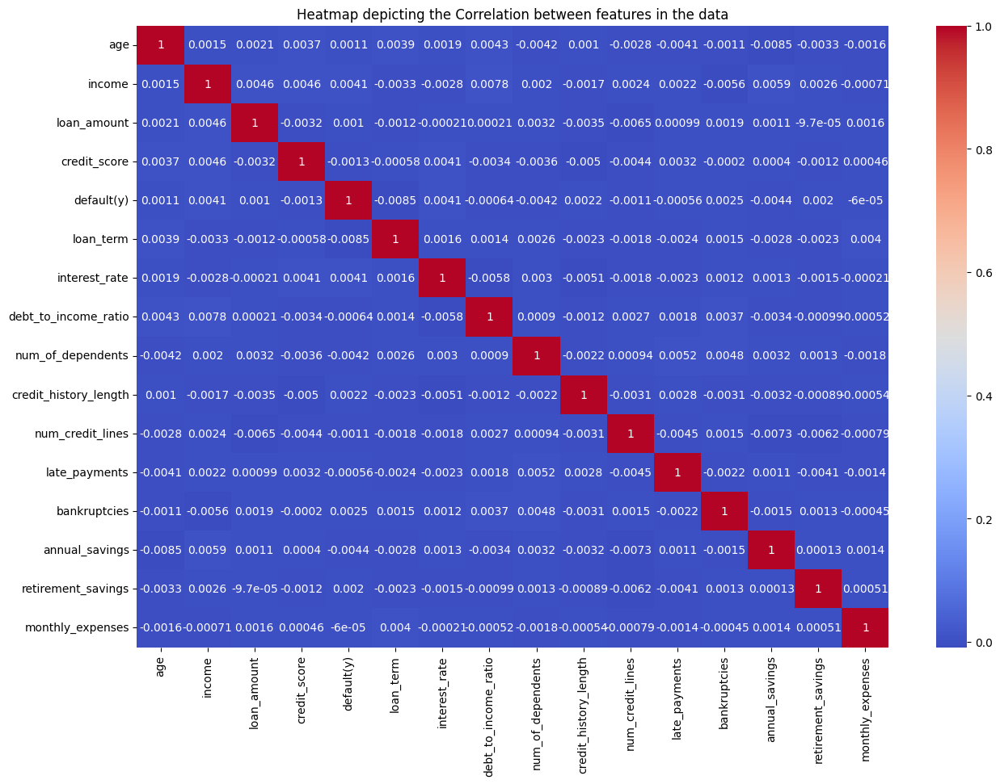

In [87]:
plt.figure(figsize = (15,10))
sns.heatmap(df.corr(numeric_only = True), annot = True, cmap = 'coolwarm')
plt.title('Heatmap depicting the Correlation between features in the data')
plt.show()

As a general rule, 
* If correlation between features > **0.7** or <  **-0.7** --> Features are said to be **strongly correlated**.
* If correlation lies between **0.4** and **0.7** or **-0.4** and **-0.7** --> Features are said to be **weakly correlated**.
* If correlation is < **0.4** or > **-0.4** --> Features are not said to be **correlated** with each other.

In [101]:
# Let us confim that with a python script

In [8]:
correlated_features = set()
numeric_df = df.select_dtypes(include = ['int64', 'float64'])
df_corr = df.select_dtypes(include = ['int64', 'float64']).corr()

for i, col_1  in enumerate(numeric_df.columns):
    for j, col_2 in enumerate(numeric_df.columns):
        if i < j:
            if np.abs(df_corr[col_1][col_2]) > 0.7:
                correlated_features.add((col_1, col_2))

In [9]:
correlated_features

set()

##### Hence, we have found **no correlated features** in our dataset.

### 3. Compare default and non-default groups across key features.

In [180]:
# First let us compare the default and non-default groups for the Categorical Column

In [181]:
# Lets display the values in categorical column
categorical

['employment_status', 'education_level', 'home_ownership', 'marital_status']

##### Now, since the default column and all the features in categorical are non-numeric, we will calculate cross tabulation first, just like we do in Chi-Square test and then plot the bar charts accordingly.

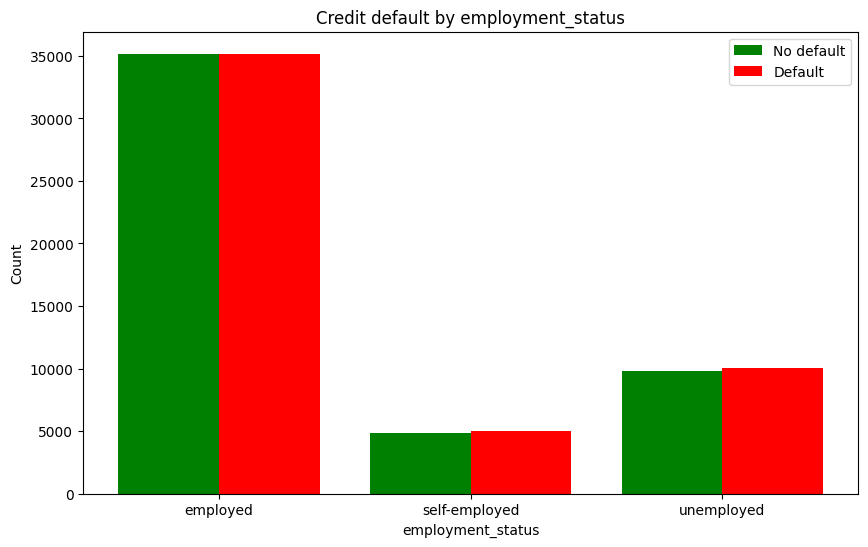

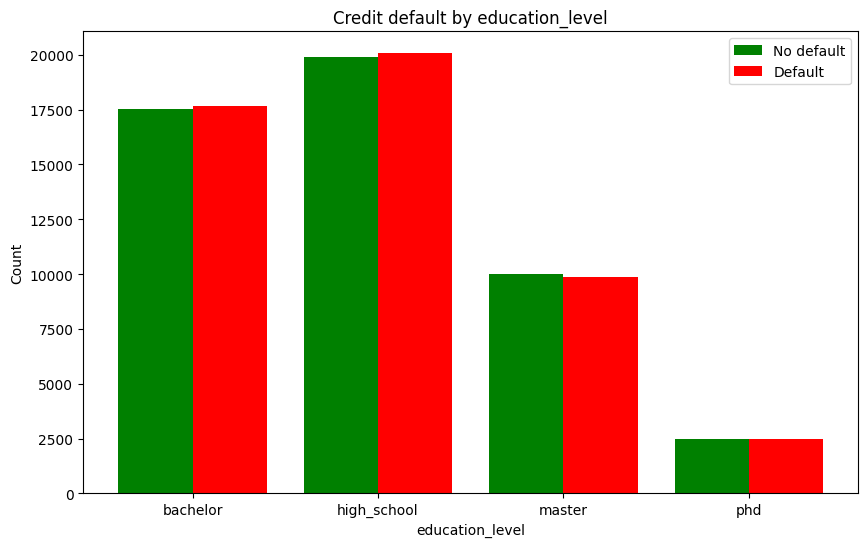

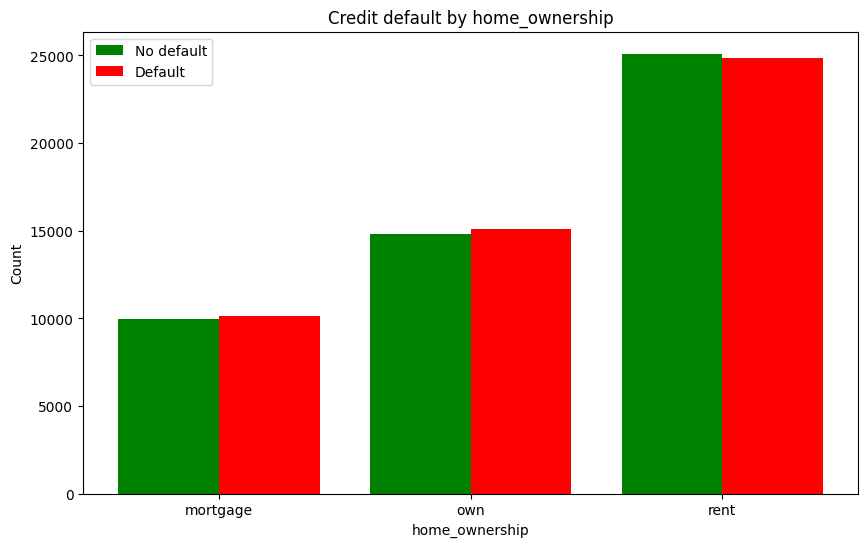

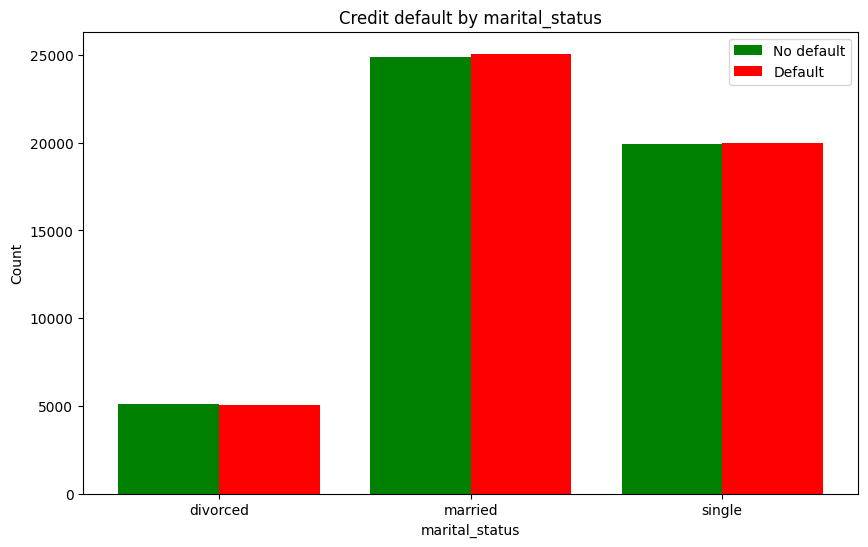

In [179]:
bar_width = 0.4  # Setting up the bar width
for cols in categorical:
    df_cross = pd.crosstab(index = df['default(y)'], columns = df[cols]) # Calculating cross tabulations
    categories = df_cross.columns # The columns of the resulting dataframe will be treated as categories
    default_0 = df_cross.values[0]  # The first row will be respect to the values where default column = 0
    default_1 = df_cross.values[1]  # The second row will show all the values where default column = 1
    x = np.arange(len(categories))  # Creates an array that can be plotted on x - axis
    plt.figure(figsize = (10,6))
    plt.bar(x - bar_width/2, default_0, width = bar_width, label = 'No default', color = 'green') # x is manipulated such that the bars dont overlap
    plt.bar(x + bar_width/2, default_1, width = bar_width, label = 'Default', color = 'red')
    plt.xticks(x, categories)   # sets the x to their original column names which is categories
    plt.xlabel(cols)
    plt.title(f'Credit default by {cols}')
    plt.ylabel('Count')
    plt.legend()
    plt.show()

#### We can see no significant difference between the number of defaulters and non - defaulters in all the categories

In [183]:
# Lets us now proceed to the discrete features

In [184]:
discrete

['default(y)', 'loan_term', 'num_of_dependents', 'bankruptcies']

##### Since we have discrete features here with numerical data we can use **Group By Aggregation**. Also, lets use Plotly for more interactive visuals.

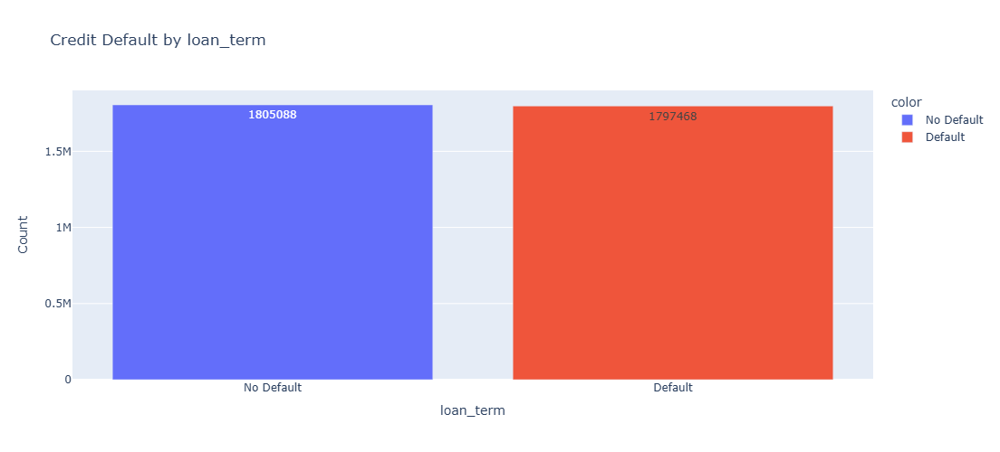

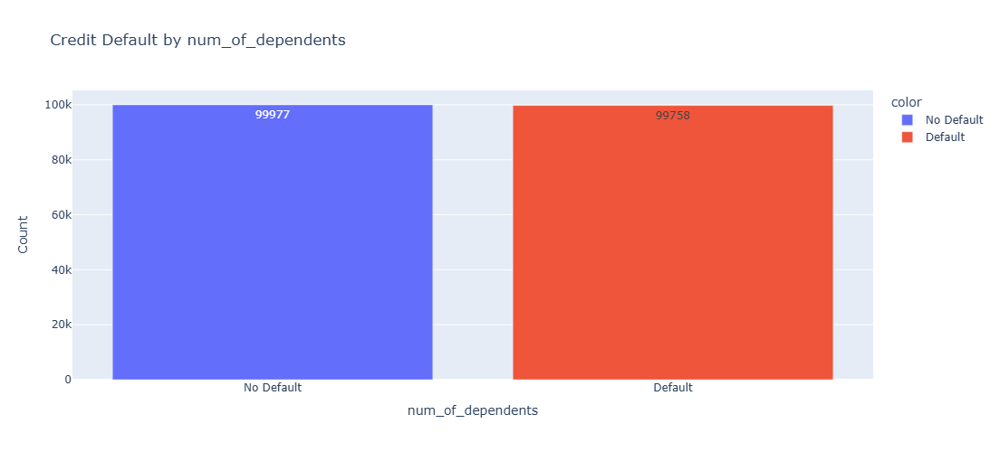

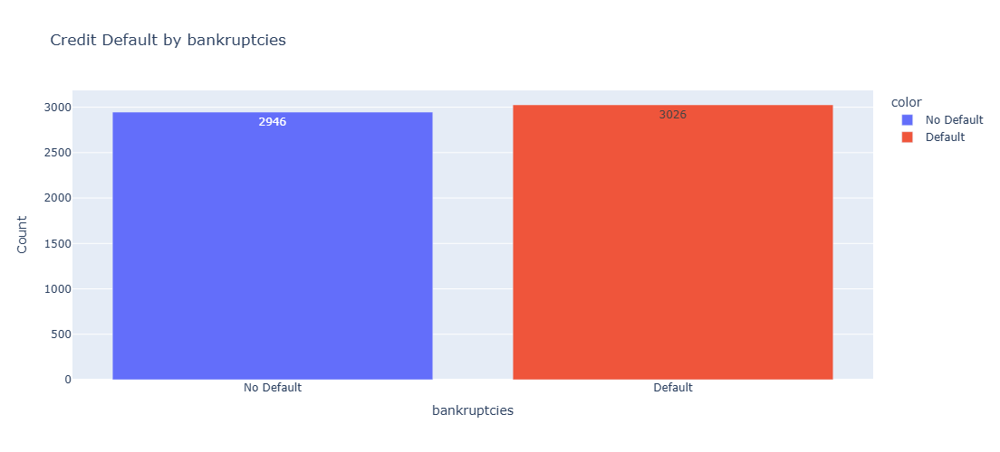

In [239]:
for i in range(1,len(discrete)):  # To exclude the first value which is default(y) as we are comparing with this value
    df_group = df.groupby(discrete[0]).agg({discrete[i] : np.sum})   # Created a Group By Aggregation
    labels_map = {0 : 'No Default', 1 : 'Default'}
    fig = px.bar(x = df_group.index.map(labels_map),
                 y = df_group[discrete[i]],
                 text_auto = 'd',
                 height = 500,
                 width = 850,
                 color = df_group.index.map(labels_map),
                 labels = {'x' : discrete[i], 'y' : 'Count'},
                 text = df_group[discrete[i]],
                 title = f'Credit Default by {discrete[i]}')
    fig.show()
    
    

#### Here too, We can see no significant difference between the number of defaulters and non - defaulters in all the categories

In [240]:
# Let us now check the same for Continuous Features

In [241]:
continuous

['age',
 'income',
 'loan_amount',
 'credit_score',
 'interest_rate',
 'debt_to_income_ratio',
 'credit_history_length',
 'num_credit_lines',
 'late_payments',
 'annual_savings',
 'retirement_savings',
 'monthly_expenses']

##### We shall create the **box plots** to compare the features with our target variable which is **'default(0)'**

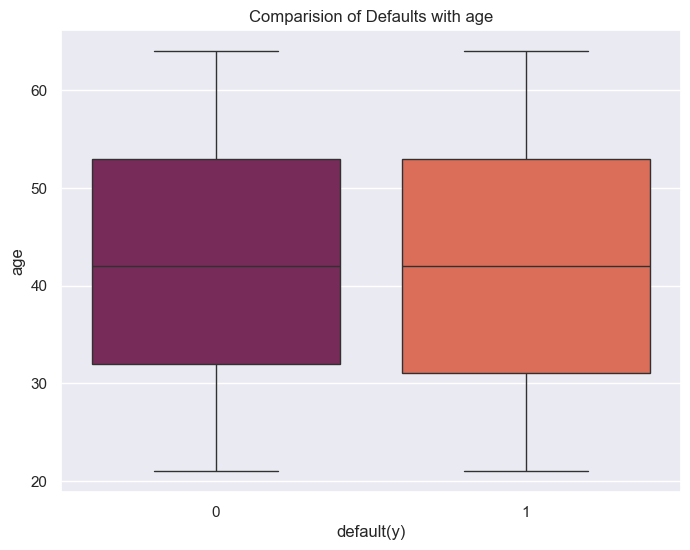

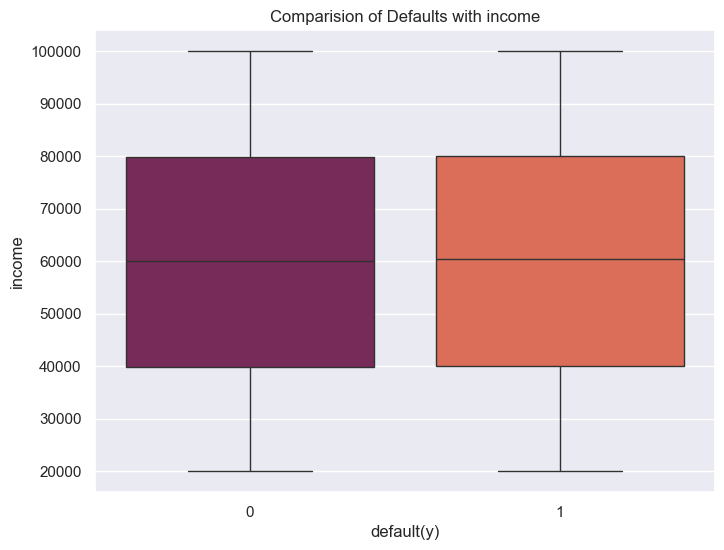

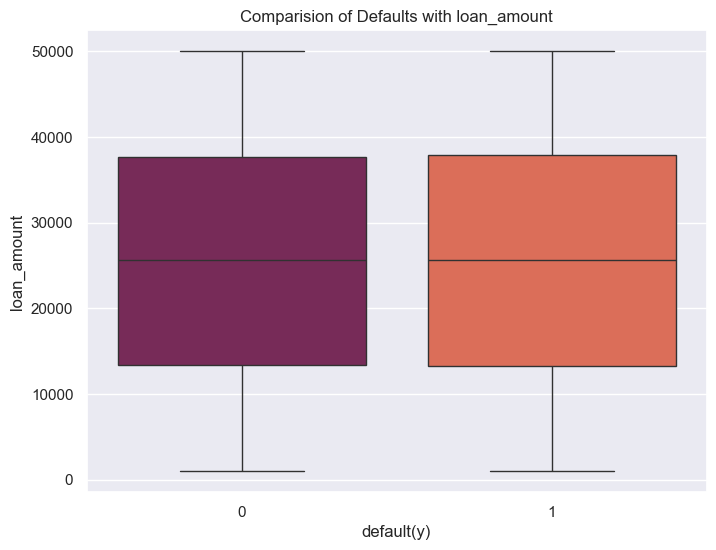

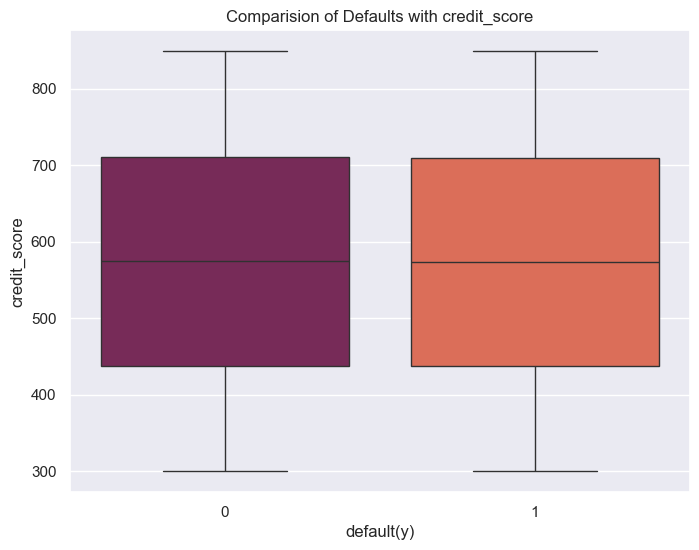

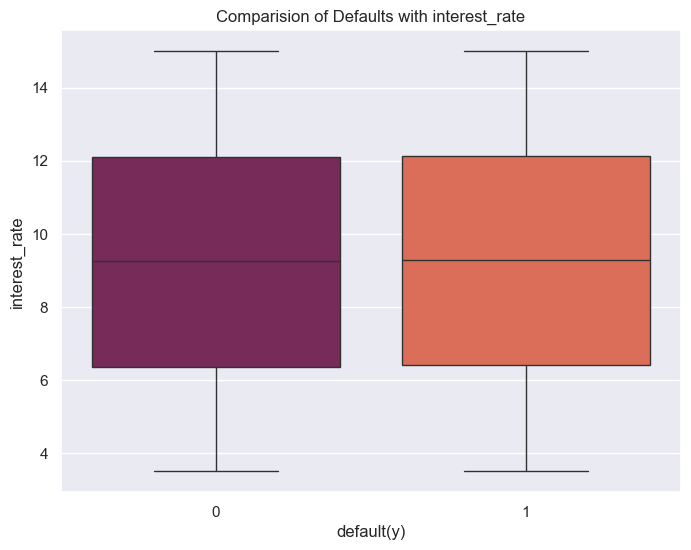

...

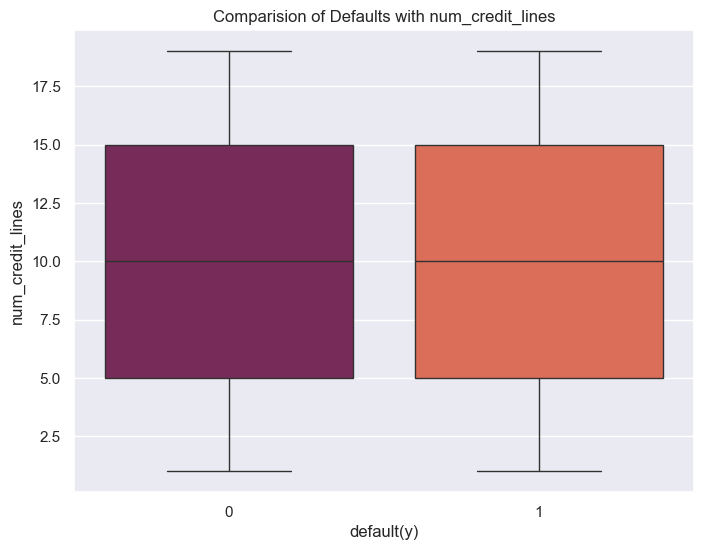

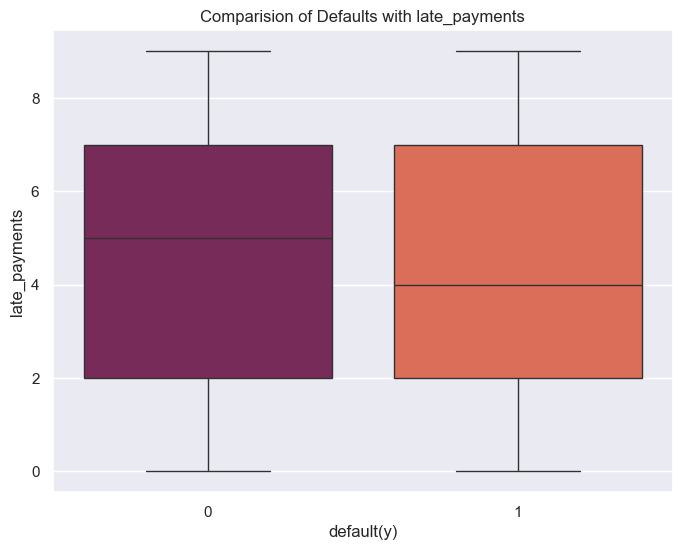

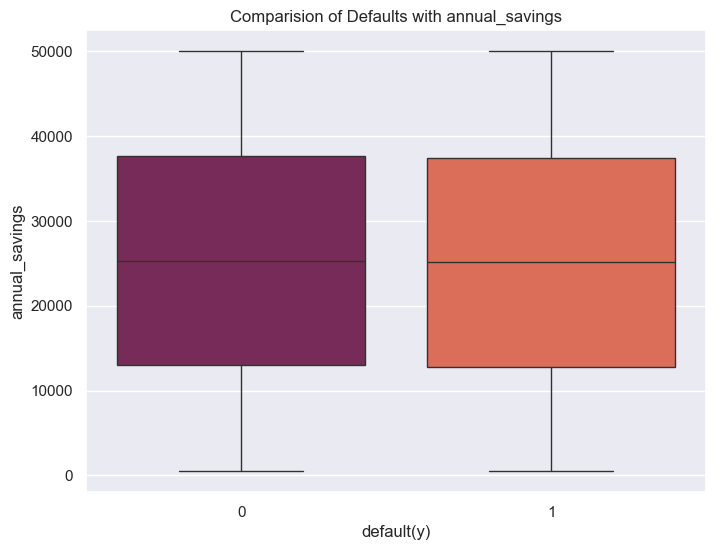

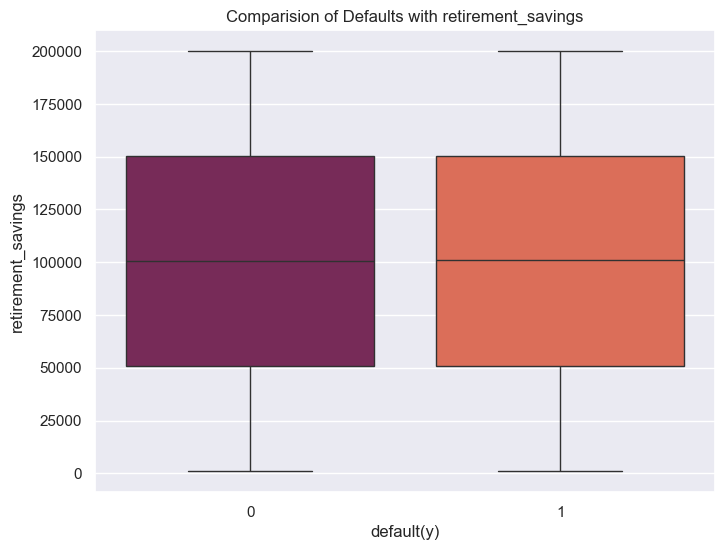

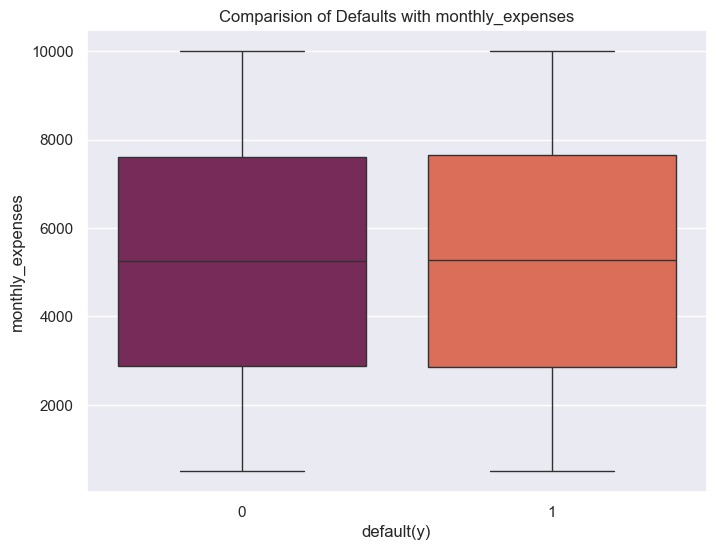

In [32]:
for cols in continuous:
    plt.figure(figsize = (8,6))
    sns.boxplot(data = df, x = 'default(y)', y = cols, palette = 'rocket')
    plt.title(f'Comparision of Defaults with {cols}')
    plt.xlabel('default(y)')
    plt.ylabel(cols)
    plt.show()

### 4. Identify outliers in features like income, loan_amount, and credit_score.

##### Let us use our function to detect outliers like we did earlier for these continuous features.

In [277]:
# We have these continuous features in our data

In [278]:
continuous

['age',
 'income',
 'loan_amount',
 'credit_score',
 'interest_rate',
 'debt_to_income_ratio',
 'credit_history_length',
 'num_credit_lines',
 'late_payments',
 'annual_savings',
 'retirement_savings',
 'monthly_expenses']

In [279]:
# Let us check for outliers in each one of them

In [282]:
for cols in continuous:
    print(f'{cols} --> {outlier_feature(cols)}')
    print()

age --> No Outliers found

income --> No Outliers found

loan_amount --> No Outliers found

credit_score --> No Outliers found

interest_rate --> No Outliers found

debt_to_income_ratio --> No Outliers found

credit_history_length --> No Outliers found

num_credit_lines --> No Outliers found

late_payments --> No Outliers found

annual_savings --> No Outliers found

retirement_savings --> No Outliers found

monthly_expenses --> No Outliers found



##### Hence, no outliers are present in our dataset for features like income, loan_amount, and credit_score, etc.,

## Questions

### Which features show a strong correlation with default?

##### Let us write a python script to find out the correlation of all the features with our target feature which is 'default(0)'

In [30]:
max_correl = []  # List to store all the correlation name, value pairs
for cols in df_corr.columns:
    if cols != 'default(y)':
        val = np.abs(df_corr['default(y)'][cols])
        max_correl.append((cols,val))
max_correl.sort(key = lambda x : x[1],reverse=True) # Sort the correlation values in the decreasing order to get the maximum value on the top.
max_correl

[('loan_term', 0.008484354784177292),
 ('annual_savings', 0.004380454084923027),
 ('num_of_dependents', 0.004193818337918052),
 ('income', 0.004135870536527819),
 ('interest_rate', 0.004053080454069776),
 ('bankruptcies', 0.002483021634885609),
 ('credit_history_length', 0.002196686508762669),
 ('retirement_savings', 0.001987656005428331),
 ('credit_score', 0.0012842481990716725),
 ('num_credit_lines', 0.0010973971263612474),
 ('age', 0.0010835224760249308),
 ('loan_amount', 0.0010142973009498635),
 ('debt_to_income_ratio', 0.0006372998795406433),
 ('late_payments', 0.0005589270242457985),
 ('monthly_expenses', 6.007922827221018e-05)]

##### We can see that there is no significant correlation of any any feature with the target. The maximum we have is for **loan_term** which is approx **0.0085**

### Are there significant differences in income or loan amount between defaulters and non-defaulters?

##### There are several methods to find out this like, plotting box plots, condcuting statistical analysis etc., We shall choose to observe **Box plots** and perform **t-test**

##### **Box Plots** - we have already plotted box plots of income vs default(y) and loan_amont vs default(y) with all other features too. Let us plot them again to study further.

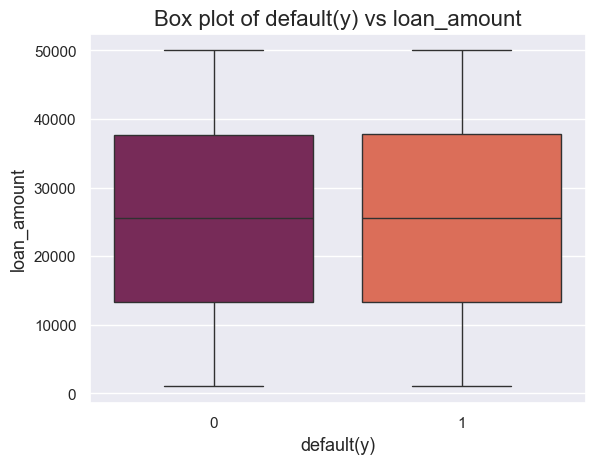

In [41]:
# Box plot of default(y) vs loan_amount
sns.boxplot(data = df, x = 'default(y)', y = 'loan_amount', palette = 'rocket')
plt.title('Box plot of default(y) vs loan_amount', fontsize = 16)
plt.xlabel('default(y)', fontsize = 13)
plt.ylabel('loan_amount', fontsize = 13)
plt.show()

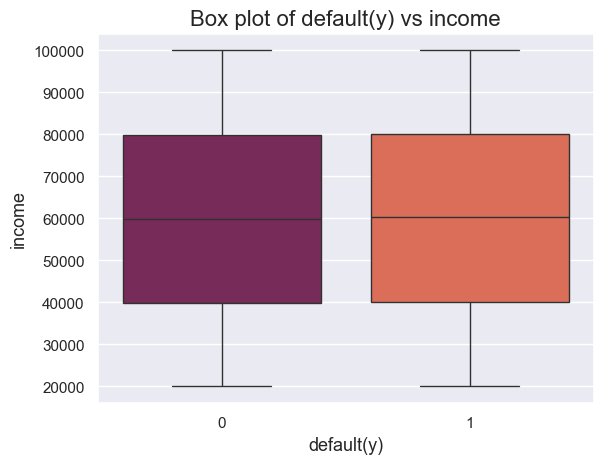

In [42]:
# Box plot of default(y) vs loan_amount
sns.boxplot(data = df, x = 'default(y)', y = 'income', palette = 'rocket')
plt.title('Box plot of default(y) vs income', fontsize = 16)
plt.xlabel('default(y)', fontsize = 13)
plt.ylabel('income', fontsize = 13)
plt.show()

##### **<u>Observations:</u>** We can see that there is **no significant difference** in means of **defaulters** and **non-defaulters** with respect to the **income** and **loan_amount**.

##### **T-test** --> We are using t-test to determine if the difference in means between defaulters and non-defaulters is statistically significant. we get p-values for our T-test.
##### **p-value** determines whether the differnce is significant or not. As a general rule:
* ##### If p-value < 0.05, the difference is statistically significant.
* ##### If p-value > 0.05, there is no strong evidence of a difference.


In [52]:
from scipy.stats import ttest_ind # Importing t-test from scipy.stats

# Splitting data into two groups, one where for the income of defaulters and one for the income of non-defaulters.
income_defaulters = df[df['default(y)'] == 1]['income']
income_non_defaulters = df[df['default(y)'] == 0]['income']

# Splitting data into two groups, one where for the loan amount of defaulters and one for the loan amount of non-defaulters.
loan_defaulters = df[df['default(y)'] == 1]['loan_amount']
loan_non_defaulters = df[df['default(y)'] == 0]['loan_amount']

# Performing independent t-tests
income_ttest = ttest_ind(income_defaulters, income_non_defaulters)
loan_ttest = ttest_ind(loan_defaulters, loan_non_defaulters)

print("Income t-test:", income_ttest)
print("Loan Amount t-test:", loan_ttest)
print()
# Interpreting the results
if income_ttest[1] < 0.05:
    print('There is statistically significant difference between the means of defaulters and non-defaulters with respect to income')
else:
    print('There is no strong evidence of a significant difference between the means of defaulters and non-defaulters with respect to income')

if loan_ttest[1] < 0.05:
    print('There is statistically significant difference between the means of defaulters and non-defaulters with respect to loan amount')
else:
    print('There is no strong evidence of a significant difference between the means of defaulters and non-defaulters with respect to loan amount')

Income t-test: TtestResult(statistic=1.3078752073931863, pvalue=0.1909186465051669, df=99998.0)
Loan Amount t-test: TtestResult(statistic=0.32074592704211047, pvalue=0.74840361009887, df=99998.0)

There is no strong evidence of a significant difference between the means of defaulters and non-defaulters with respect to income
There is no strong evidence of a significant difference between the means of defaulters and non-defaulters with respect to loan amount


##### **<u>Observations:</u>** The result of T-test supports our Box plot observation of **no significant difference** in means of **defaulters** and **non-defaulters** with respect to the **income** and **loan_amount**.

In [55]:
credit_default = df[df['default(y)'] == 1]['credit_score']
credit_non_default = df[df['default(y)'] == 0]['credit_score']

In [56]:
ttest_ind(credit_default, credit_non_default)

TtestResult(statistic=-0.40611121273238654, pvalue=0.6846617564237976, df=99998.0)

In [59]:
df.corr(numeric_only=True)['credit_score']['default(y)']

-0.0012842481990716725

In [60]:
df.corr(numeric_only=True)['default(y)']['credit_score']

-0.0012842481990716725

### Do credit scores impact the likelihood of default?

##### To check the impact of credit score on the likelihood of default, let us check the correlation between them. If it comes out be > 0.7 or < -0.7, we shall conclude that the credit score impacts the likelihood of default otherwise it would be clear that they are independent.

In [61]:
# From the correlation matrix let us find the value corresponding to just credit score and default(y) and interpret the result.
correlation_value = df.corr(numeric_only = True)['credit_score']['default(y)']
if np.abs(correlation_value) > 0.7:
    print('Credit score does impact the likelihood of default')
else:
    print('Credit score does not impact the likelihood of default')


Credit score does not impact the likelihood of default


##### **<u>Observation:</u>** Credit score **does not** impact the likelihood of default

# 3. Data Preprocessing
## <u>Tasks</u>
### 1. Handle missing values (imputation with mean/median/mode).

##### We have no missing values in our dataset. Let us confirm that

In [62]:
count_missing_values = df.isna().sum().sum()
if count_missing_values == 0:
    print('There are no missing values in our dataset')
else:
    print(f'The number of missing values in our dataset is {count_missing_values}')

There are no missing values in our dataset


### 2. Convert categorical variables into numerical form (e.g., one-hot encoding).

##### Let us check what our categorical variables are

In [65]:
categorical

['employment_status', 'education_level', 'home_ownership', 'marital_status']

##### Let us apply **One Hot Encoding** sicne all these variables are nominal in nature. We shall apply the **get_dummies()** method of pandas

In [68]:
df_encoded = pd.get_dummies(df, columns = categorical, drop_first = True, dtype = 'int')
# converting our categorical variables stored in 'categorical' list to numerical form while keeping drop_first = True (to avoid multicollinearity)

In [69]:
# Displaying the first 5 rows to confirm changes
df_encoded.head()

,age,income,loan_amount,credit_score,default(y),loan_term,interest_rate,debt_to_income_ratio,num_of_dependents,credit_history_length,num_credit_lines,late_payments,bankruptcies,annual_savings,retirement_savings,monthly_expenses,employment_status_self-employed,employment_status_unemployed,education_level_high_school,education_level_master,education_level_phd,home_ownership_own,home_ownership_rent,marital_status_married,marital_status_single
0,38,71440,27069,689,1,36,9.937874,31.046101,0,7,6,1,1,25259,195208,6037,1,0,1,0,0,0,1,1,0
1,36,90200,14895,578,0,48,13.624882,21.845252,0,11,16,8,0,40761,152999,4064,0,0,1,0,0,1,0,1,0
2,47,85896,2613,352,1,12,6.676366,12.562405,1,24,2,2,0,34857,67487,2848,0,0,0,0,0,0,0,0,0
3,38,20121,3163,622,0,48,12.833366,17.144545,1,12,4,6,1,16048,98869,7721,0,1,0,1,0,1,0,1,0
4,44,77529,37731,615,0,12,4.111636,35.892430,3,27,7,5,0,5668,42397,8009,1,0,1,0,0,1,0,0,1


##### Categorical features are successfully coverted into numbers.

### 3. Split the dataset into training (80%) and testing (20%) sets.

##### first, let us create saperate our input features and target feature before splitting the data.

In [85]:
x = df_encoded.drop(columns=['default(y)'])  # Drop target column to get features
y = df_encoded['default(y)']  # Extract target column

In [86]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 42)
# Splitting the data into train and test with 80% of training data and 20% of testing using sklearn train test split

### 4. Normalize numerical features (e.g., standardization or MinMax scaling).

##### *As a general rule, if our data contains outliers, we **Normalize** our data or use **Min Max Scaler** to scaler our data. While, if we have data* 
##### *without outliers, we **Standardize** our data our use **Standard scaler** to scale our data. Since, we have no outliers in our data, we use **Standard Scaler***

In [87]:
scaler = StandardScaler() # Creating an object of Standard Scaler class
x_train_scaled = scaler.fit_transform(x_train) # scaler in fitted on x_train and x_train is transformed.
x_test_scaled = scaler.transform(x_test) # x_test is transformed using the same scaling parameters derived from x_train

## Questions
### How will you handle missing values in categorical and numerical features?

#### **Numerical Features:** - We handle the missing values in numerical features in following ways:
* ##### Removing missing values - if the percentage of missing values is < 30%, we simply drop those rows.
* ##### Dropping the entire column - if the percentage of missing values is significant that is > 50% we drop the entire column.
* ##### Imputing with Mean -  if our data is not skewed, we impute the missing values with Mean.
* ##### Imputing with Median - if our data is skewed, we impute the missing values with Median.
* ##### We can also use advanced methods like KNN Imputation to handle the missing values as well.

#### **Categorical Features:** - We handle the missing values in categorical features in following ways:
* ##### Removing missing values - if the percentage of missing values is < 30%, we simply drop those rows.
* ##### Dropping the entire column - if the percentage of missing values is significant that is > 50% we drop the entire column.
* ##### Imputing with Mode - To handle missing values in categorical data, we impute the missing values with Mode.

### Why is it necessary to normalize numerical features?

##### Normalization (or scaling) of numerical features is essential in machine learning for the following reasons:
* ##### Ensures Equal Weightage in Distance-Based Algorithms - Algorithms like KNN, SVM, and K-Means rely on distance metrics (e.g., Euclidean distance). If features are on different scales, features with larger values will dominate distance calculations.
* ##### Faster Convergence in Gradient-Based Optimization - Models like Logistic Regression, Linear Regression, and Neural Networks use gradient descent for optimization. If features are on vastly different scales, the cost function will have an elongated shape, leading to slow convergence or even failing to converge.
* ##### Avoids Bias in Regularization Techniques - Regularization techniques like L1 (Lasso) and L2 (Ridge) penalize large coefficients. If features are not scaled, larger magnitude features will have higher penalties, leading to incorrect importance assignment.

### What technique would you use to convert categorical variables to numerical?

##### There are majorly two methods:
* ##### One-Hot Encoding - When we do not have ordinal relationships between categories for ex, Names of countries
* ##### Label Encoding - When we have ordinal relationships between categories for ex, 'Low', 'Medium', 'High'

# 4. Model Selection & Training
## <u>Tasks</u>
### 1. Train a Logistic Regression model as a baseline.

In [107]:
logistic = LogisticRegression() # creating the object of Logistic Regression algorithm
model = logistic.fit(x_train_scaled, y_train) # fitting the algorithm on x_train_scaled and y_train
y_pred_test = model.predict(x_test_scaled) # Making predictions of test data
y_pred_train = model.predict(x_train_scaled) # Making predictions on training data to evaluate the performance

# Evaluation
print(confusion_matrix(y_test, y_pred_test)) # printing confusion matrix to check precision, recall, etc.,
print(classification_report(y_test, y_pred_test)) # printing classification report
accuracy_test = accuracy_score(y_test, y_pred_test)
print(accuracy_test) # displaying accuracy score

[[4298 5741]
 [4330 5631]]
              precision    recall  f1-score   support

           0       0.50      0.43      0.46     10039
           1       0.50      0.57      0.53      9961

    accuracy                           0.50     20000
   macro avg       0.50      0.50      0.49     20000
weighted avg       0.50      0.50      0.49     20000

0.49645


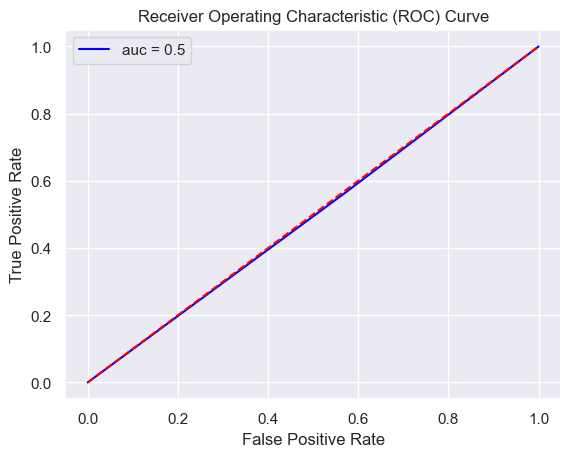

In [104]:
# Let us also plot the roc_auc curve
fpr, tpr, _ = roc_curve(y_test, y_pred_test)
plt.plot(fpr,tpr, color = 'blue', label = f'auc = {round(auc(fpr,tpr),2)}') # Plotting false postitive rate vs true posotive rate with area under curve.
plt.plot(fpr,fpr, linestyle = 'dashed', color = 'red')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

In [118]:
# Checking for Overfitting and Underfitting
accuracy_train = accuracy_score(y_train, y_pred_train)
print(accuracy_train)
if accuracy_test < 0.7:
    if np.abs(accuracy_train - accuracy_test) > 0.1 :
        print('Model is Overfitting')
    print('Model is Underfitting')

0.506575
Model is Underfitting


##### Interpretation:
* ##### We are getting an accuracy of around **49.6%**.
* ##### This is also evident from the roc_auc curve.
* ##### The accuract is coming out to be < 70%, Hence our **Basline model is Underfitting**.

### 2. Experiment with Decision Tree, Random Forest, and Gradient Boosting models.

In [132]:
# Let us create a dictionary to store these models
models = {
    'Decision_Tree' : DecisionTreeClassifier(),
    'Random_Forest' : RandomForestClassifier(),
    'Xg_boost' : XGBClassifier(),
    'Lightgbm' : LGBMClassifier(verbose = -1),
    'CatBoost' : CatBoostClassifier()
}

results = {} # Let us create another dictionary to store the results

# Training the data on these algorithms
for name, model in models.items():
    mod = model.fit(x_train_scaled, y_train)
    y_pred_train = mod.predict(x_train_scaled)
    y_pred_test = mod.predict(x_test_scaled)
    accuracy_train = accuracy_score(y_train, y_pred_train)
    accuracy_test = accuracy_score(y_test, y_pred_test)
    precision = precision_score(y_test, y_pred_test)
    recall = recall_score(y_test, y_pred_test)
    f1 = f1_score(y_test, y_pred_test)
    print(confusion_matrix(y_test, y_pred_test)) 
    print(classification_report(y_test, y_pred_test))
    fpr, tpr, _ = roc_curve(y_test, y_pred_test)
    print(f'Area under curve for {name} --> {auc(fpr, tpr)}')
    results[name] = {'accuracy' : accuracy_test, 'precision' : precision, 'recall' : recall, 'F1' : f1}
    print()

[[5012 5027]
 [4945 5016]]
              precision    recall  f1-score   support

           0       0.50      0.50      0.50     10039
           1       0.50      0.50      0.50      9961

    accuracy                           0.50     20000
   macro avg       0.50      0.50      0.50     20000
weighted avg       0.50      0.50      0.50     20000

Area under curve for Decision_Tree --> 0.5014084064218617

[[5264 4775]
 [5262 4699]]
              precision    recall  f1-score   support

           0       0.50      0.52      0.51     10039
           1       0.50      0.47      0.48      9961

    accuracy                           0.50     20000
   macro avg       0.50      0.50      0.50     20000
weighted avg       0.50      0.50      0.50     20000

Area under curve for Random_Forest --> 0.4980474003009587

[[5034 5005]
 [5048 4913]]
              precision    recall  f1-score   support

           0       0.50      0.50      0.50     10039
           1       0.50      0.49     

In [133]:
results # Displaying the results

{'Decision_Tree': {'accuracy': 0.5014,
  'precision': 0.4994523548740416,
  'recall': 0.5035638992069069,
  'F1': 0.501499700059988},
 'Random_Forest': {'accuracy': 0.49815,
  'precision': 0.49598902258813593,
  'recall': 0.47173978516213233,
  'F1': 0.48356058657062},
 'Xg_boost': {'accuracy': 0.49735,
  'precision': 0.4953619681387377,
  'recall': 0.49322357193052907,
  'F1': 0.4942904572664621},
 'Lightgbm': {'accuracy': 0.4959,
  'precision': 0.4941921858500528,
  'recall': 0.5168155807649835,
  'F1': 0.5052507606242026},
 'CatBoost': {'accuracy': 0.5022,
  'precision': 0.5002487314695055,
  'recall': 0.5047685975303684,
  'F1': 0.5024985008994604}}

In [127]:
feature_importance = []
for i, j in zip(x.columns, mod_rf.feature_importances_):
    feature_importance.append((i,j))
feature_importance.sort(key = lambda x : x[1], reverse = True)
feature_importance

[('monthly_expenses', 0.0811035741067669),
 ('debt_to_income_ratio', 0.08075642258805933),
 ('retirement_savings', 0.08074657628221885),
 ('interest_rate', 0.08064136087329161),
 ('annual_savings', 0.08055069599395237),
 ('income', 0.08050371688685685),
 ('loan_amount', 0.08035688401367791),
 ('credit_score', 0.07860519687422343),
 ('age', 0.06390147202072419),
 ('credit_history_length', 0.0560543229499095),
 ('num_credit_lines', 0.05176984413874686),
 ('late_payments', 0.0431643495154663),
 ('num_of_dependents', 0.029008670421817366),
 ('loan_term', 0.02802358993047276),
 ('education_level_high_school', 0.011159325570286626),
 ('marital_status_married', 0.010087649191273569),
 ('home_ownership_rent', 0.00989349683196231),
 ('marital_status_single', 0.009711236955080351),
 ('employment_status_unemployed', 0.0092950017409457),
 ('home_ownership_own', 0.009107029762295675),
 ('education_level_master', 0.008573930384765272),
 ('employment_status_self-employed', 0.006777466920259086),
 ('b

### 3. Compare models based on accuracy, precision, recall, and F1-score.

In [135]:
# Converting the results dictionary into data frame for better interpretation.
results_df = pd.DataFrame(results).T
results_df

,accuracy,precision,recall,F1
Decision_Tree,0.50140,0.499452,0.503564,0.501500
Random_Forest,0.49815,0.495989,0.471740,0.483561
Xg_boost,0.49735,0.495362,0.493224,0.494290
Lightgbm,0.49590,0.494192,0.516816,0.505251
CatBoost,0.50220,0.500249,0.504769,0.502499


##### We can observe that all our models have their **accuracy**, **precision**, **recall** and **f1 score** in the same range.

In [136]:
# Let us plot our results using plotly for better interpretation

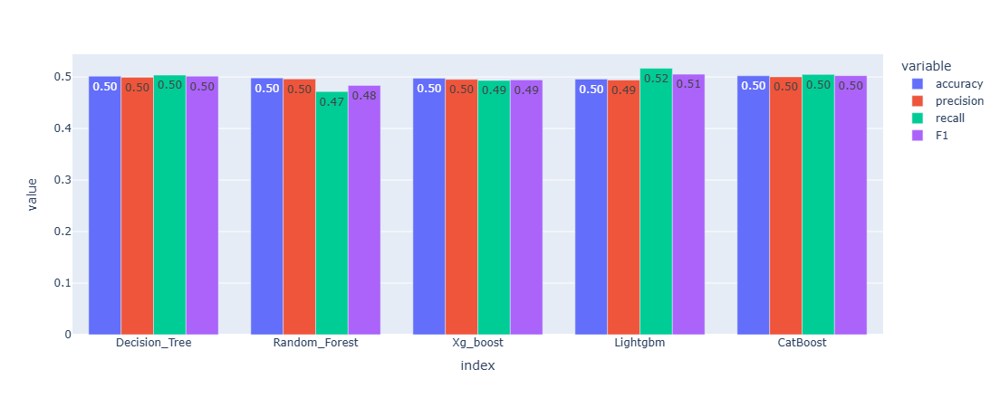

In [148]:
px.bar(results_df, barmode = 'group', text_auto = '.2f', height = 450)

## Questions
### What is the advantage of using a Logistic Regression model as a baseline?

##### The main advantage of using Logistic Regression model as base model is that it is a simple linear model and can serve as a good base for comparing
##### other models.

### Which model performs best, and why?

##### So far, all our models are performing more or less in the same way with an accuracy of approx 50%.

### What are the potential weaknesses of Decision Trees compared to Random Forest?

##### Decision Trees are highly prone to overfitting. It memorizes the training data instead of generalizing well. While Random Forest reduces overfitting by averaging multiple decision trees, making predictions more robust and stable.
##### Also, decision trees works well on simple data but struggles with complex data as compared to random forest.
##### Random forest is more robust to outliers as compared to Decision trees.

# 5. Model Evaluation
## <u>Tasks</u>
### 1. Compute evaluation metrics: Accuracy, Precision, Recall, F1-score.

In [159]:
# The evaluation metrics for our algorithms are presented as:-

In [161]:
results_df

,accuracy,precision,recall,F1
Decision_Tree,0.50140,0.499452,0.503564,0.501500
Random_Forest,0.49815,0.495989,0.471740,0.483561
Xg_boost,0.49735,0.495362,0.493224,0.494290
Lightgbm,0.49590,0.494192,0.516816,0.505251
CatBoost,0.50220,0.500249,0.504769,0.502499


### 2. Generate a confusion matrix to analyze false positives and false negatives.

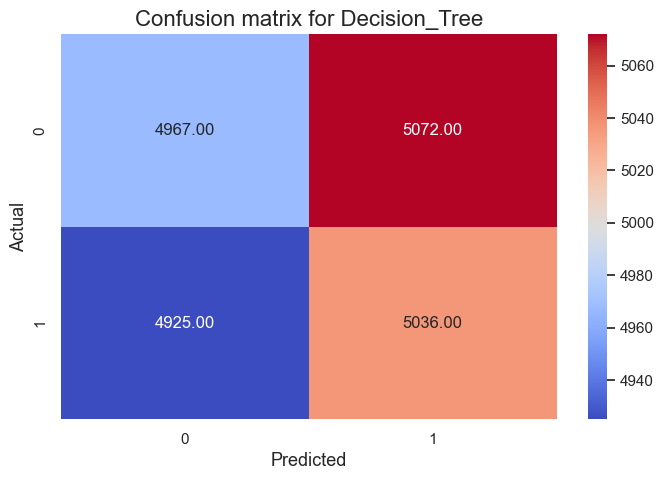

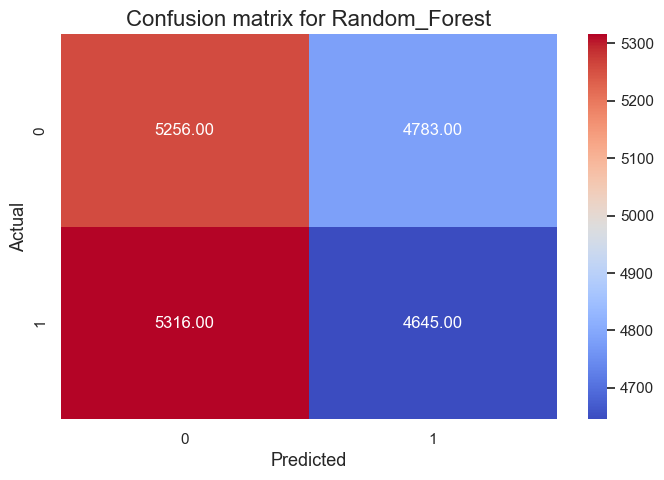

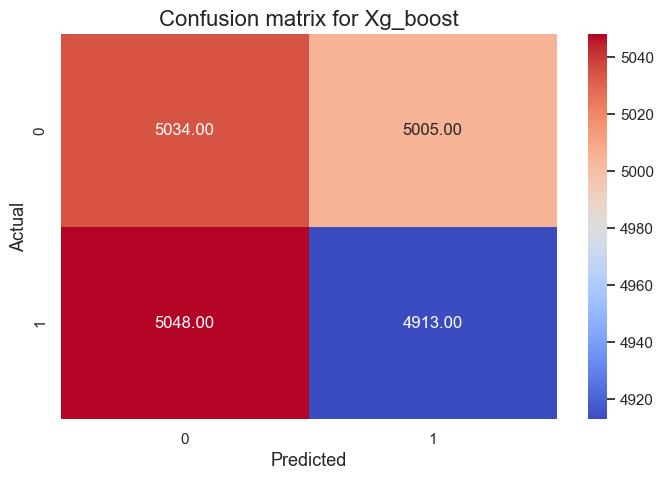

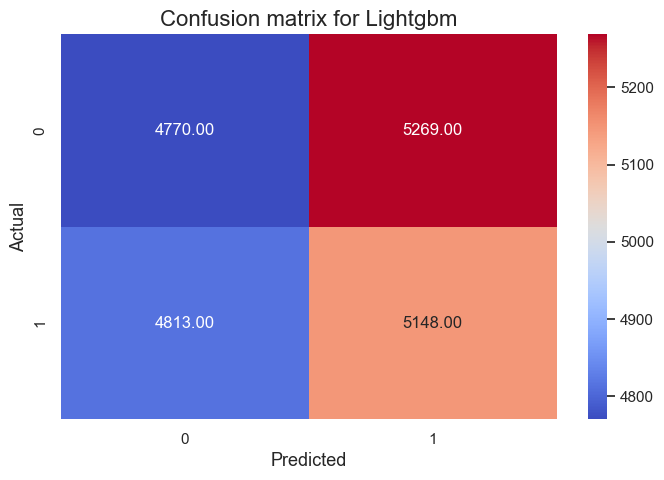


Learning rate set to 0.06692
0:	learn: 0.6930740	total: 22.6ms	remaining: 22.5s
1:	learn: 0.6929888	total: 41.9ms	remaining: 20.9s
2:	learn: 0.6929253	total: 62.6ms	remaining: 20.8s
3:	learn: 0.6928542	total: 83.6ms	remaining: 20.8s
4:	learn: 0.6927655	total: 105ms	remaining: 20.9s
5:	learn: 0.6926988	total: 131ms	remaining: 21.7s
6:	learn: 0.6926358	total: 152ms	remaining: 21.6s
7:	learn: 0.6925499	total: 174ms	remaining: 21.5s
8:	learn: 0.6924748	total: 193ms	remaining: 21.3s
9:	learn: 0.6924045	total: 214ms	remaining: 21.2s
10:	learn: 0.6923324	total: 235ms	remaining: 21.1s
11:	learn: 0.6922654	total: 256ms	remaining: 21.1s
12:	learn: 0.6921859	total: 275ms	remaining: 20.9s
13:	learn: 0.6921189	total: 296ms	remaining: 20.9s
14:	learn: 0.6920580	total: 316ms	remaining: 20.7s
15:	learn: 0.6920071	total: 347ms	remaining: 21.4s
16:	learn: 0.6919395	total: 370ms	remaining: 21.4s
17:	learn: 0.6918798	total: 392ms	remaining: 21.4s
18:	learn: 0.6917911	total: 412ms	remaining: 21.3s
19:	lea

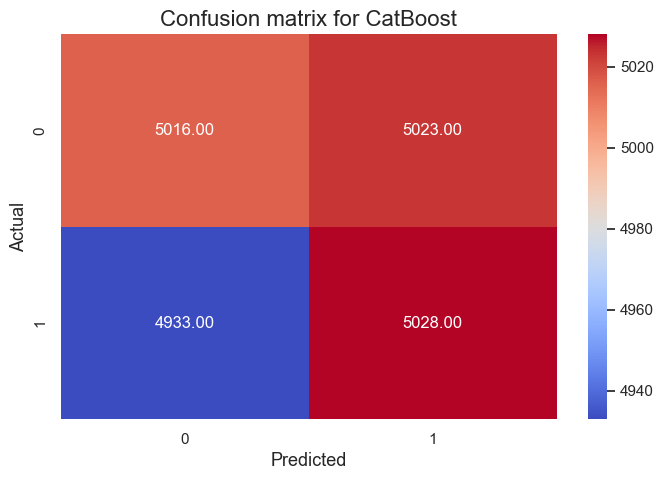

In [168]:
for name, model in models.items():
    mod = model.fit(x_train_scaled, y_train)
    y_pred_test = mod.predict(x_test_scaled)
    conf_mat = confusion_matrix(y_test, y_pred_test) 
    plt.figure(figsize = (8,5))
    sns.heatmap(conf_mat, annot = True, fmt = '.2f', cmap = 'coolwarm')
    plt.title(f'Confusion matrix for {name}', fontsize = 16)
    plt.xlabel('Predicted', fontsize = 13)
    plt.ylabel('Actual', fontsize = 13)
    plt.show()
    print()

### Why is precision-recall more important than accuracy for this dataset?
##### In this dataset, we are predicting credit risk hence in this case, the number of false negatives (the actual defaulters are tagged as non -defaulters), is important.
##### Since, it increases the risk of ignoring defaulters and can cause financial loss to the bank. Also, the number of false positives(the non defaulters are
##### tagged as defaulters) also becomes important as a geniune credit taker might be subject to unnecessary validations and proofs hence damaging the bank reputation.
##### Hence, accuracy is not alone a good evaluator of our model in this case.

### How does the confusion matrix help in assessing model performance?
##### A confusion matrix provides details about a classification model’s performance by showing how many predictions were correct or incorrect. 
##### It helps assess accuracy, precision, recall, and F1-score, making it crucial for evaluating model effectiveness—especially on imbalanced datasets.

### What does a high false negative rate indicate in credit risk prediction?
##### A high false negative rate (FNR) in credit risk prediction means the model fails to identify many actual defaulters, incorrectly classifying them as low-risk borrowers.
##### A high False Negative Rate means the model misses many actual defaulters hence it may lead to financical loss for the borrowers.
##### Banks may issue loans to individuals who won’t repay, increasing non-performing loans (NPLs).

# 6. Hyperparameter Tuning
## <u>Tasks</u>
### 1. Optimize model hyperparameters using Grid Search or Random Search

In [171]:
# Let us make a dictionary with the model and their hyparameters that we shall tune.

In [173]:
models_param = {
    
    'Logistic_Regression' : {
        
        'model' : LogisticRegression(), 
        'params' : {                                 # Tuning parameters such as C, penalty, solver
            'C': [0.001, 0.01, 0.1, 1, 10, 100],
            'penalty': ['l1', 'l2'],
            'solver': ['liblinear', 'saga']}
    },
    'Decision_Tree' : {

        'model' : DecisionTreeClassifier(),         # Tuning max depth and mininum samples split
        'params' : {
            'max_depth' : [5, 10, 15, 20],
            'min_samples_split' : [2,4,6,8]}
    },
    'Random_Forest' : {

        'model' : RandomForestClassifier(),
        'params' : {                                # Tuning n_estimators (number of decision trees) and max_depth (depth of each tree)
            'n_estimators' : [100,150,200,250],
            'max_depth' : [5,10,15,20],
            'min_samples_split' : [2,4,6,8]}
    },
    'XgBoost' : {

        'model' : XGBClassifier(),
        'params' : {                               # Tuning number of gradient boosted trees, max_depth and learning rate
            'n_estimators' : [100,150,200,250],
            'max_depth' : [5,10,15,20],
            'learning_rate': [0.01, 0.1]}
    },
    'Light GBM': {
        'model': LGBMClassifier(verbose=-1),  # verbose is set to -1 to avoid displaying the iterartions.
        'params': {'n_estimators': [50, 100], 'learning_rate': [0.01, 0.1]} # Tuning number of trees and learning rate.
    },
    'Cat Boost': {
        'model': CatBoostClassifier(verbose=0),
        'params': {'iterations': [100, 200], 'learning_rate': [0.01, 0.1]} # Tuning number of iterations and learning rate.
    }
}

In [177]:
results_tuned = {}  # Created a dictionary to store the results of hyperparameter tuning
for name, model_info in models_param.items():
    grid_search = GridSearchCV(estimator = model_info['model'], param_grid = model_info['params'], cv = 5, scoring = 'accuracy', n_jobs = -1)
    # Creating a grid search object with model and params info from our models_with_params dictionary with scoring parameter set as r2_score, 
    # cross-validation as 5 and n_jobs = -1 which depicts end to end job utilizing whole cpu.
    model_grid = grid_search.fit(x_train_scaled, y_train)  # Training grid search object for each model on our training data.
    best_model = model_grid.best_estimator_  # finding the best model with tuned hyperparameters and storing it in a variable.
    y_pred_tuned = best_model.predict(x_test_scaled) # Making predictions from our tuned model.
    accuracy_tuned = accuracy_score(y_test, y_pred_tuned)
    precision_tuned = precision_score(y_test, y_pred_tuned)
    recall_tuned = recall_score(y_test, y_pred_tuned)
    f1_tuned = f1_score(y_test, y_pred_tuned)
    results_tuned[name] = {'accuracy_tuned' : accuracy_tuned, 'precision_tuned' : precision_tuned, 'recall_tuned' : recall_tuned, 'f1_tuned' : f1_tuned}

In [178]:
results_tuned

{'Logistic_Regression': {'accuracy_tuned': 0.50195,
  'precision_tuned': 0.0,
  'recall_tuned': 0.0,
  'f1_tuned': 0.0},
 'Decision_Tree': {'accuracy_tuned': 0.4985,
  'precision_tuned': 0.4963703314045239,
  'recall_tuned': 0.4736472241742797,
  'f1_tuned': 0.48474262817219765},
 'Random_Forest': {'accuracy_tuned': 0.5029,
  'precision_tuned': 0.5009014137963753,
  'recall_tuned': 0.5299668707961048,
  'f1_tuned': 0.5150243902439025},
 'XgBoost': {'accuracy_tuned': 0.4981,
  'precision_tuned': 0.4962251201098147,
  'recall_tuned': 0.5080815179198875,
  'f1_tuned': 0.5020833333333333},
 'Light GBM': {'accuracy_tuned': 0.49615,
  'precision_tuned': 0.49509638146770374,
  'recall_tuned': 0.5878927818492119,
  'f1_tuned': 0.5375189315709762},
 'Cat Boost': {'accuracy_tuned': 0.5015,
  'precision_tuned': 0.49956093277392916,
  'recall_tuned': 0.5140046180102399,
  'f1_tuned': 0.5066798614547254}}

In [181]:
# Converting the results_tuned dictionary into data frame for better interpretation.
results_tuned_df = pd.DataFrame(results_tuned).T
results_tuned_df

,accuracy_tuned,precision_tuned,recall_tuned,f1_tuned
Logistic_Regression,0.50195,0.000000,0.000000,0.000000
Decision_Tree,0.49850,0.496370,0.473647,0.484743
Random_Forest,0.50290,0.500901,0.529967,0.515024
XgBoost,0.49810,0.496225,0.508082,0.502083
Light GBM,0.49615,0.495096,0.587893,0.537519
Cat Boost,0.50150,0.499561,0.514005,0.506680


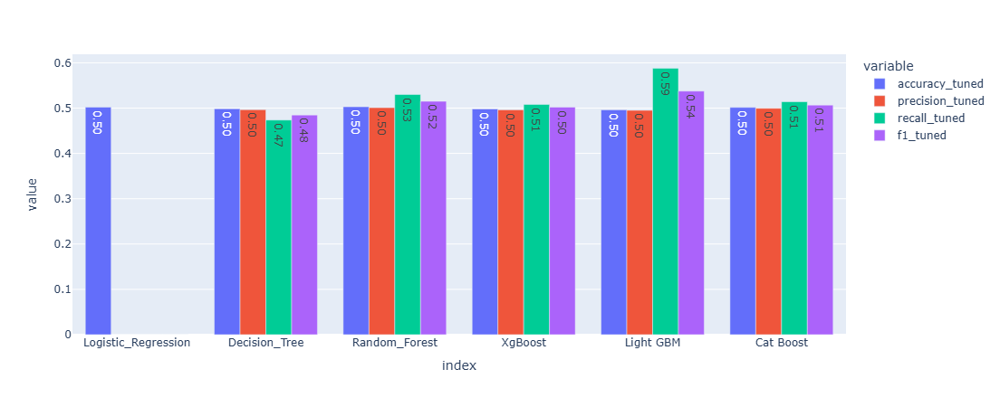

In [184]:
px.bar(results_tuned_df, barmode = 'group', text_auto = '.2f', height = 450)

##### <u>Observations</u>:- Our results are same before and after implementing hyperparameter tuning.

## Questions
### What are the key hyperparameters to tune in a Random Forest model?

##### The key hyperparameters that we usually tune in our Random Forest Model are:-
* ##### **n-estimators** - The number of trees in our Random Forest model. We tune this to increase or decrease the model complexity. More the number of trees, more complex the model becomes.
* ##### **max_depth** - The depth of each individual tree. Here also, increasing the depth increases complexityof the model.
* ##### **min_samples_split** - The minimum number of samples required to split an internal node.


### Why is cross-validation important?

##### Cross-validation (CV) is a technique used to evaluate machine learning models by splitting the data into multiple subsets for training and testing. It ensures that the model generalizes well to unseen data, preventing overfitting and underfitting.
##### Some reasons due to which cross validation is important are:-
* ##### It prevents overfitting by training the model multiple times on different subsets.
* ##### Instead of relying on a single train-test split, CV averages performance over multiple runs.

### Did tuning significantly improve model performance?
##### In our case, unfortunately tuning didn't improved model performance.

<h2 style = 'color : orangered'>Conclusion</h2>

### Summarize the most important findings from your analysis.
* ##### For all our models the accuracy, precision and recall are coming to be around 50%.
* ##### Our model is able to classify just half of the transactions correctly.

### Identify the best model for predicting loan defaults.
* ##### The best model so far in our analysis comes out to be **'LightGbm'** model.

### Discuss the real-world applications of your project.

* ##### Our project aims to identify defaulter and non-defaulters for the financial institutions that lend the money.
* ##### If given some data about the borrowers like age, income, credit_score, etc., our project can precdict that whether or not that borrower will default on the payment.
* ##### This can help lenders to reduce the risk of financial loss by mitigating the risk of a default payment.
* ##### The lenders in this way can identify the true and potential customers while reducing the losses to increase their overall profit.